# **Imports and Dependencies:**

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
import cv2

# **Functions of Morphological Operators:**
1. Dilation
2. Erosion
3. Opening
4. Closing

In [ ]:
# Dilation And Erosion Functions

def dilation_operation(image, dynamic_structuring_element):
  image = np.array(image)
  height_of_structuring_element, width_of_structuring_element = dynamic_structuring_element.shape
  extendedpadded_image = np.pad(image, ((height_of_structuring_element//2, height_of_structuring_element//2), (width_of_structuring_element//2, width_of_structuring_element//2)), mode='constant')
  output_dilated_image = np.zeros_like(image)
  for i in range(height_of_structuring_element//2, extendedpadded_image.shape[0] - height_of_structuring_element//2):
    for j in range(width_of_structuring_element//2, extendedpadded_image.shape[1] - width_of_structuring_element//2):
      neighborhood_setofpixels = extendedpadded_image[i - height_of_structuring_element//2 : i + height_of_structuring_element//2 + 1, j - width_of_structuring_element//2 : j + width_of_structuring_element//2 + 1]
      active_neighborhood_pixels = neighborhood_setofpixels[dynamic_structuring_element == 1]
      output_dilated_image[i - height_of_structuring_element//2, j - width_of_structuring_element//2] = np.max(active_neighborhood_pixels)
  return output_dilated_image

def erosion_operation(image, dynamic_structuring_element):
  image = np.array(image)
  height_of_structuring_element, width_of_structuring_element = dynamic_structuring_element.shape
  extendedpadded_image = np.pad(image, ((height_of_structuring_element//2, height_of_structuring_element//2), (width_of_structuring_element//2, width_of_structuring_element//2)), mode='constant')
  output_eroded_image = np.zeros_like(image)
  for i in range(height_of_structuring_element//2, extendedpadded_image.shape[0] - height_of_structuring_element//2):
    for j in range(width_of_structuring_element//2, extendedpadded_image.shape[1] - width_of_structuring_element//2):
      neighborhood_setofpixels = extendedpadded_image[i - height_of_structuring_element//2 : i + height_of_structuring_element//2 + 1, j - width_of_structuring_element//2 : j + width_of_structuring_element//2 + 1]
      active_neighborhood_pixels = neighborhood_setofpixels[dynamic_structuring_element == 1]
      output_eroded_image[i - height_of_structuring_element//2, j - width_of_structuring_element//2] = np.min(active_neighborhood_pixels)
  return output_eroded_image


In [ ]:
# Opening And Closing Functions

def opening_operation(image, dynamic_structuring_element):
  return dilation_operation(erosion_operation(image, dynamic_structuring_element),dynamic_structuring_element)

def closing_operation(image, dynamic_structuring_element):
  return erosion_operation(dilation_operation(image, dynamic_structuring_element),dynamic_structuring_element)

# **For Image One: Using Structuring Elements with Zeros and Ones and Non-Equal Size**
Applying The following operations:


1.   Dilation.
2.   Erosion.
3.   Opening.
4.   Closing
5.   Absolute subtraction of Dilation and Erosion..
6.   Absolute subtraction of Opening and Closing.
7.   Absolute subtraction of Opening and Dilation.
8.   Absolute subtraction of Opening and Erosion
9.   Absolute subtraction of Closing and Dilation.
10.  Absolute subtraction of Closing and Erosion


Shape Of Original Image (600, 900)
Shape Of Dilated Image 1 (600, 900)
Shape Of Dilated Image 2 (600, 900)
Shape Of Binary Original Image (600, 900)
Shape Of Binary Dilated Image 1 (600, 900)
Shape Of Binary Dilated Image 2 (600, 900)


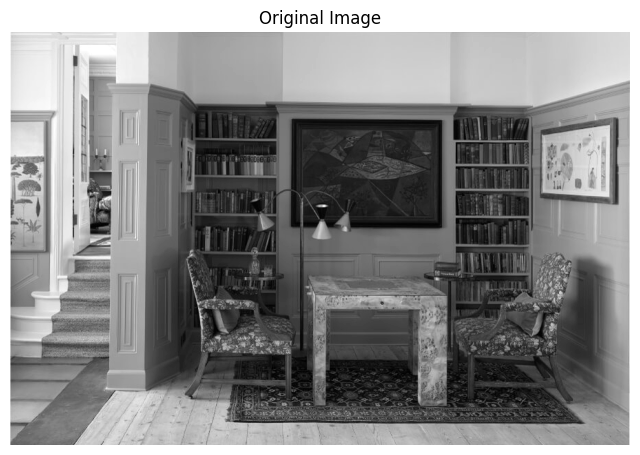

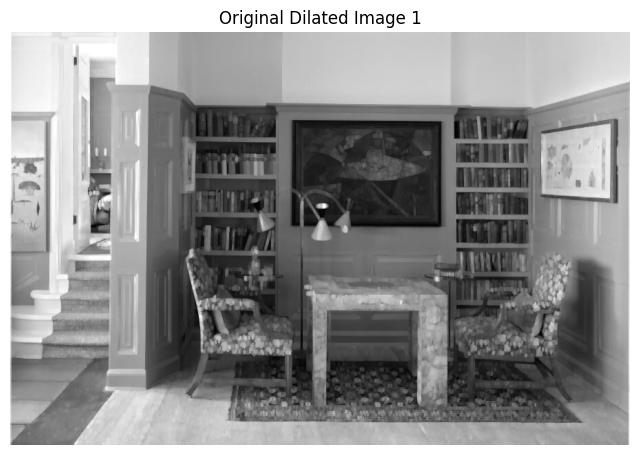

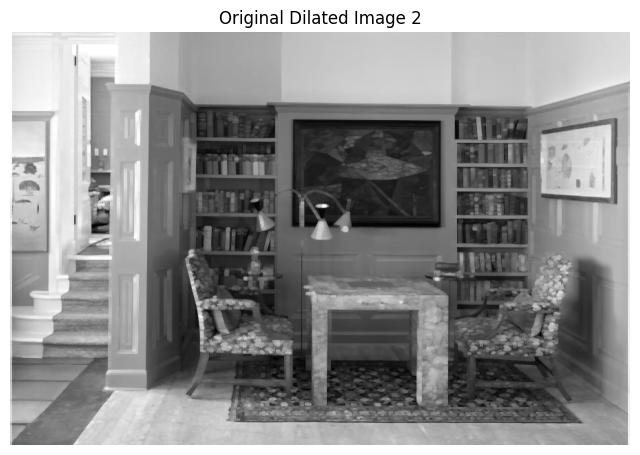

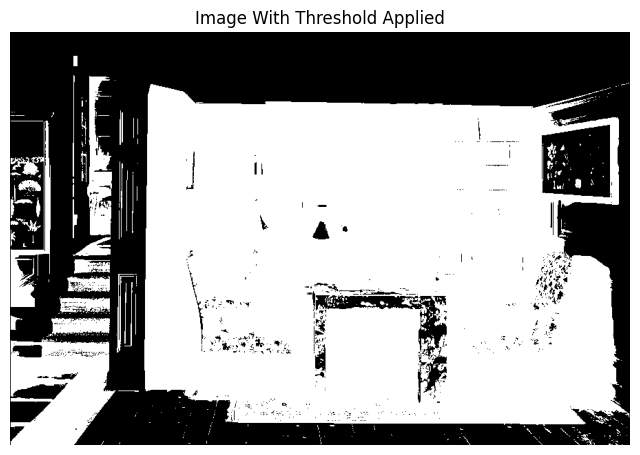

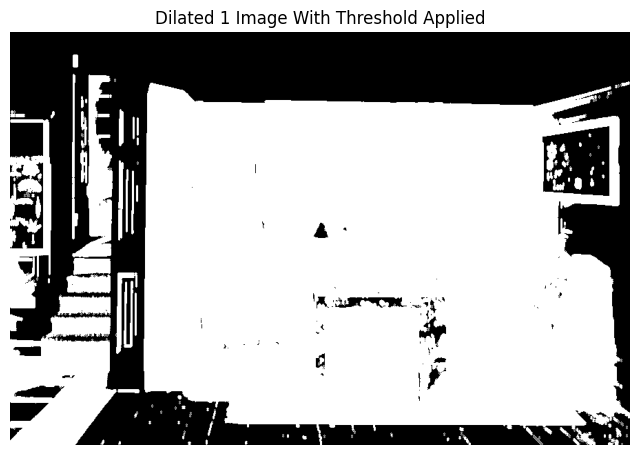

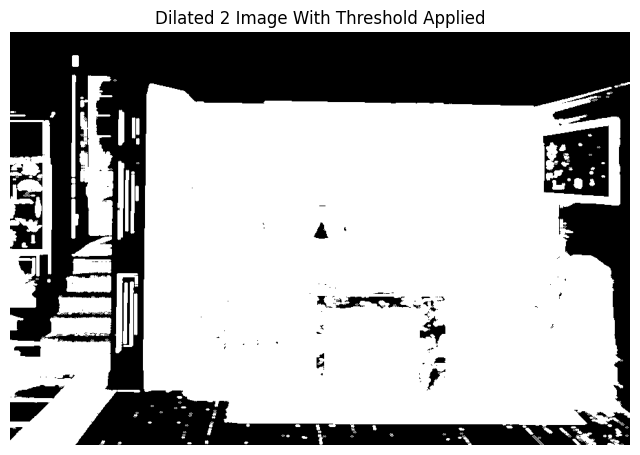

In [ ]:
# Dilation.
image_path = "/content/Test Image 1.jpeg"
image = np.array(Image.open(image_path).convert('L'))
value_of_threshold = 141
_, binary_image = cv2.threshold(image, value_of_threshold, 255, cv2.THRESH_BINARY_INV)
# _, binary_image = cv2.threshold(image, value_of_threshold, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
structuring_element1 = np.array([[0, 1, 0],
                                [1, 0 ,1],
                                [0, 1, 0],
                                [1, 0, 1],
                                [0, 1, 0]])


structuring_element2 = np.array([[0, 1, 0, 1, 0],
                                [1, 0, 1, 0, 1],
                                [0, 1, 0, 1, 0]])

dilated1 = dilation_operation(image, structuring_element1)
dilated2 = dilation_operation(image, structuring_element2)
dilated3 = dilation_operation(binary_image, structuring_element1)
dilated4 = dilation_operation(binary_image, structuring_element2)
print("Shape Of Original Image" , image.shape)
print("Shape Of Dilated Image 1" , dilated1.shape)
print("Shape Of Dilated Image 2" , dilated2.shape)
print("Shape Of Binary Original Image" , binary_image.shape)
print("Shape Of Binary Dilated Image 1" , dilated3.shape)
print("Shape Of Binary Dilated Image 2" , dilated4.shape)
# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(dilated1, cmap='gray')
plt.title('Original Dilated Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(dilated2, cmap='gray')
plt.title('Original Dilated Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(dilated3, cmap='gray')
plt.title('Dilated 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(dilated4, cmap='gray')
plt.title('Dilated 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

Shape Of Original Image (600, 900)
Shape Of Eroded Image 1 (600, 900)
Shape Of Eroded Image 2 (600, 900)
Shape Of Binary Original Image (600, 900)
Shape Of Binary Eroded Image 1 (600, 900)
Shape Of Binary Eroded Image 2 (600, 900)


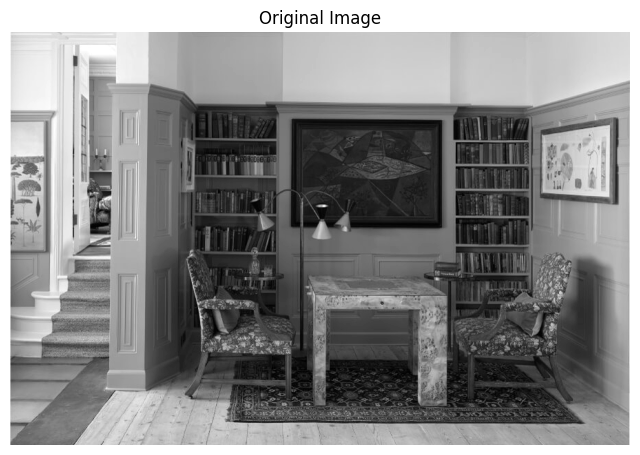

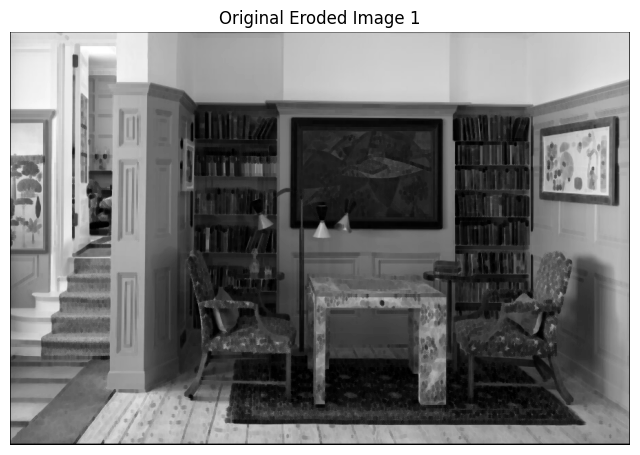

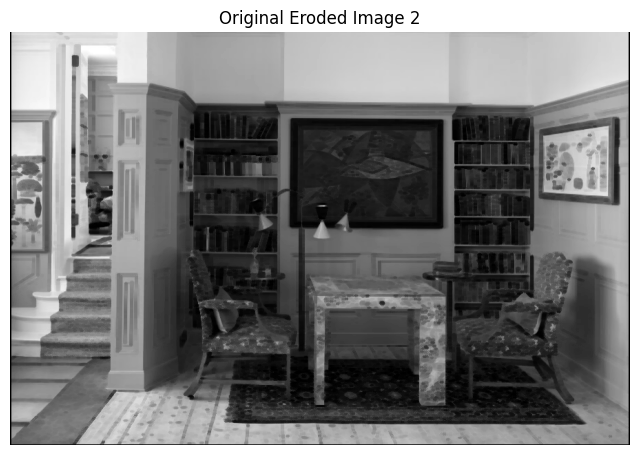

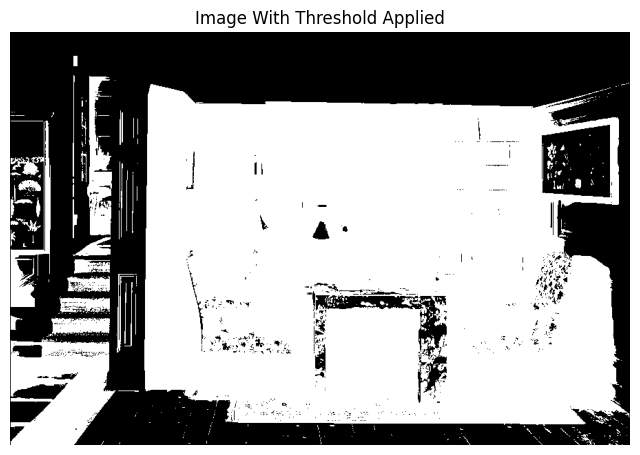

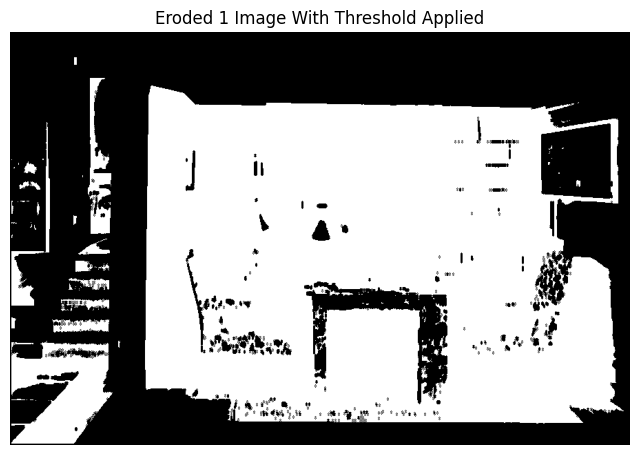

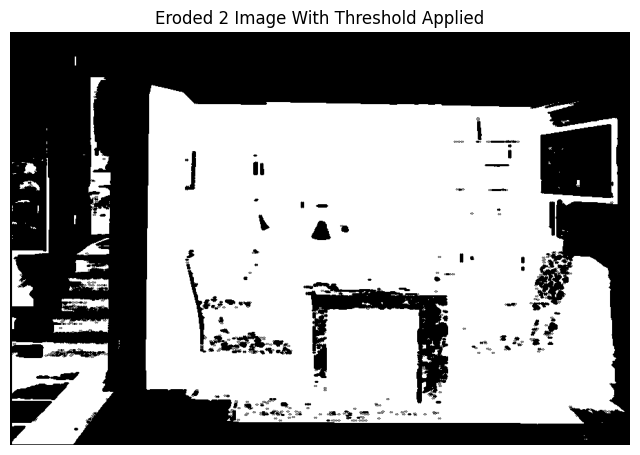

In [ ]:
# Erosion.

eroded1 = erosion_operation(image, structuring_element1)
eroded2 = erosion_operation(image, structuring_element2)
eroded3 = erosion_operation(binary_image, structuring_element1)
eroded4 = erosion_operation(binary_image, structuring_element2)
print("Shape Of Original Image" , image.shape)
print("Shape Of Eroded Image 1" , eroded1.shape)
print("Shape Of Eroded Image 2" , eroded2.shape)
print("Shape Of Binary Original Image" , binary_image.shape)
print("Shape Of Binary Eroded Image 1" , eroded3.shape)
print("Shape Of Binary Eroded Image 2" , eroded4.shape)
# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(eroded1, cmap='gray')
plt.title('Original Eroded Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(eroded2, cmap='gray')
plt.title('Original Eroded Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(eroded3, cmap='gray')
plt.title('Eroded 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(eroded4, cmap='gray')
plt.title('Eroded 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

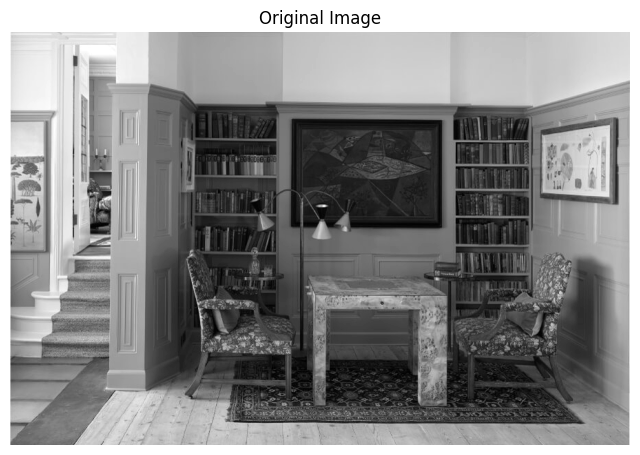

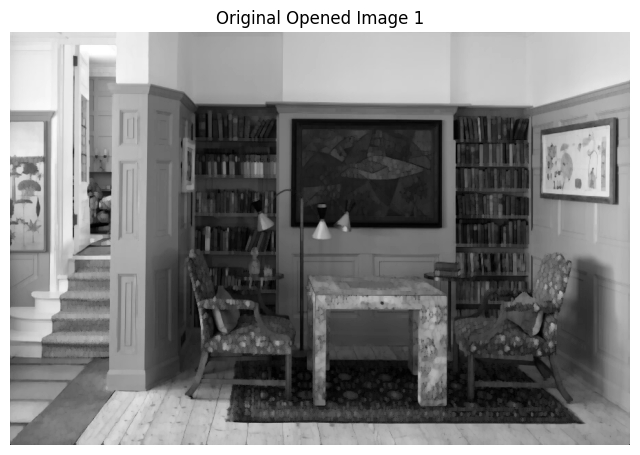

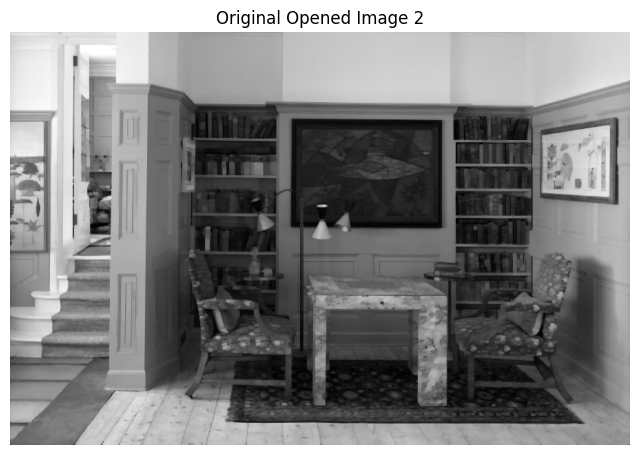

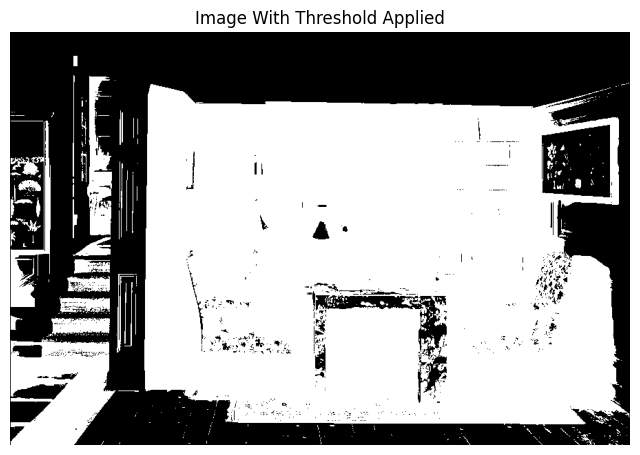

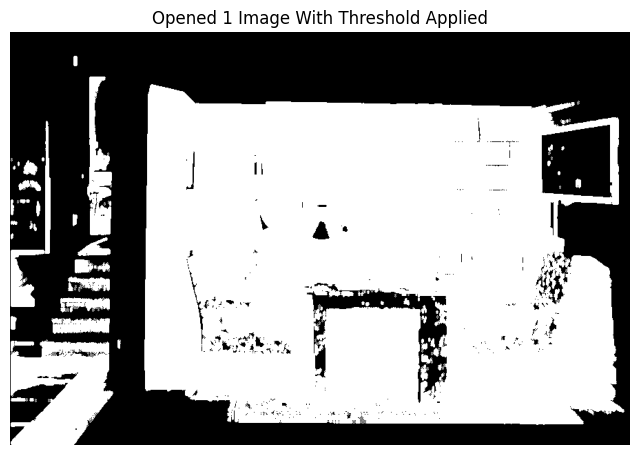

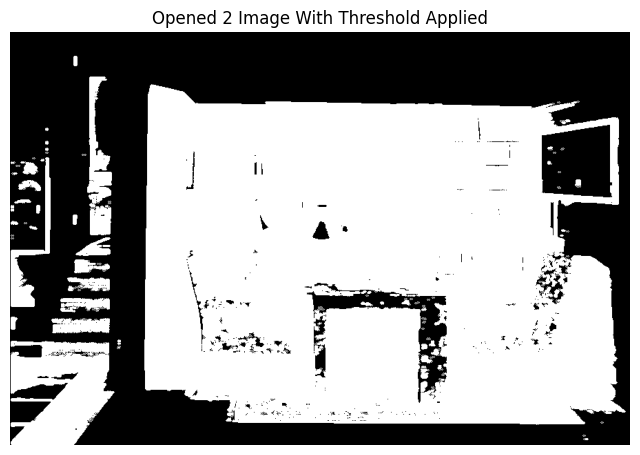

In [ ]:
# Opening.

opned1 = opening_operation(image, structuring_element1)
opned2 = opening_operation(image, structuring_element2)
opned3 = opening_operation(binary_image, structuring_element1)
opned4 = opening_operation(binary_image, structuring_element2)

# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(opned1, cmap='gray')
plt.title('Original Opened Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(opned2, cmap='gray')
plt.title('Original Opened Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(opned3, cmap='gray')
plt.title('Opened 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(opned4, cmap='gray')
plt.title('Opened 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

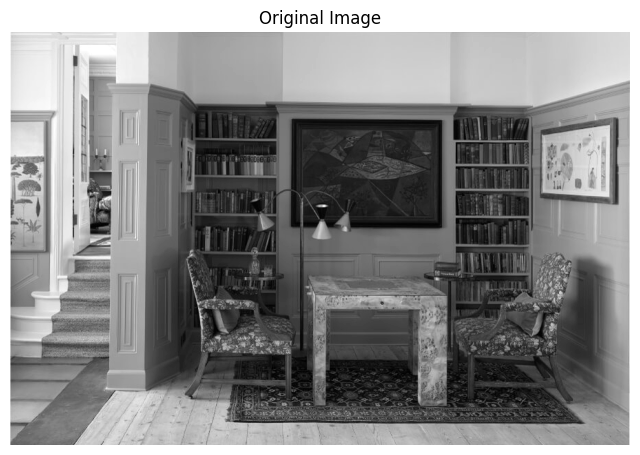

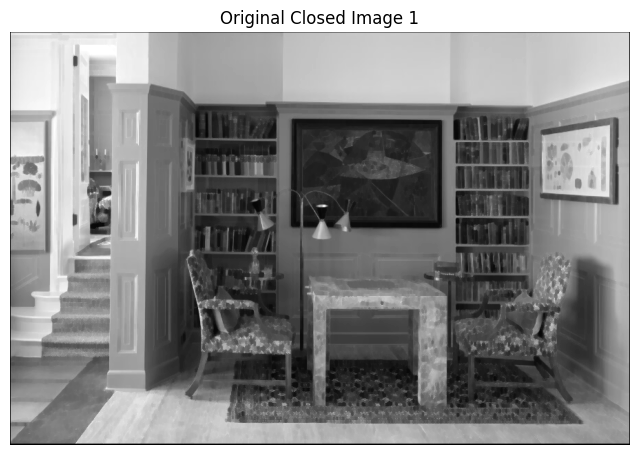

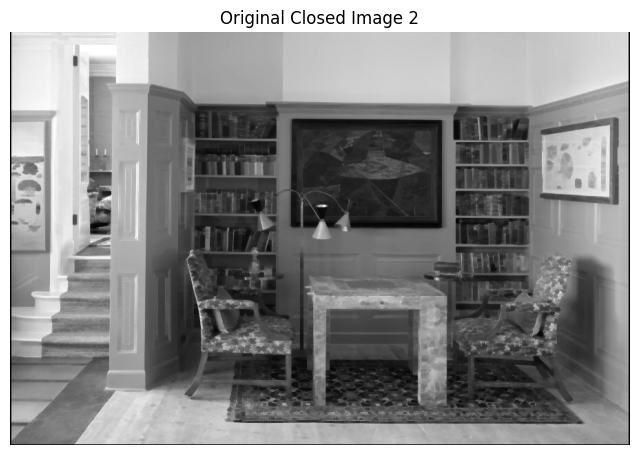

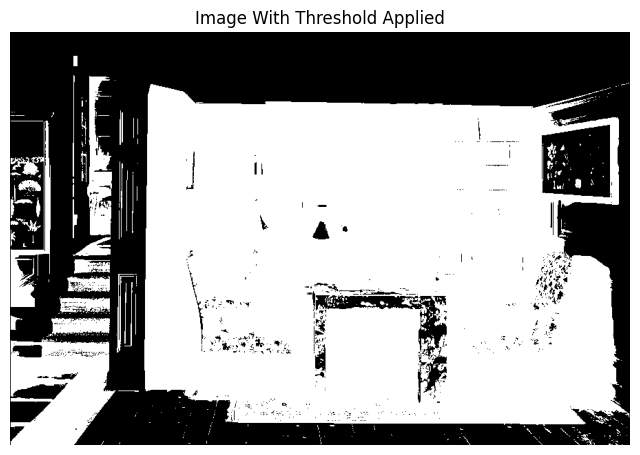

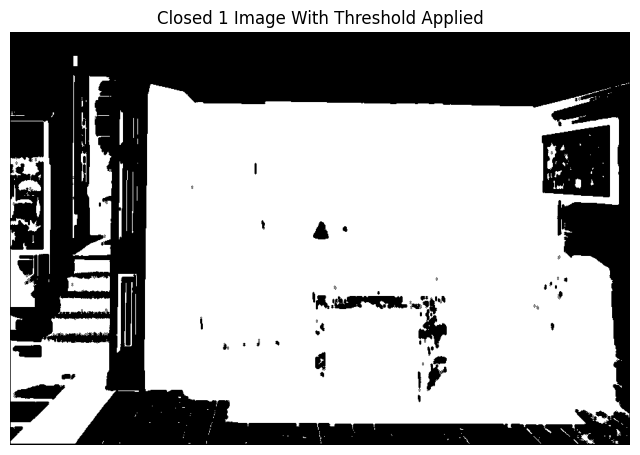

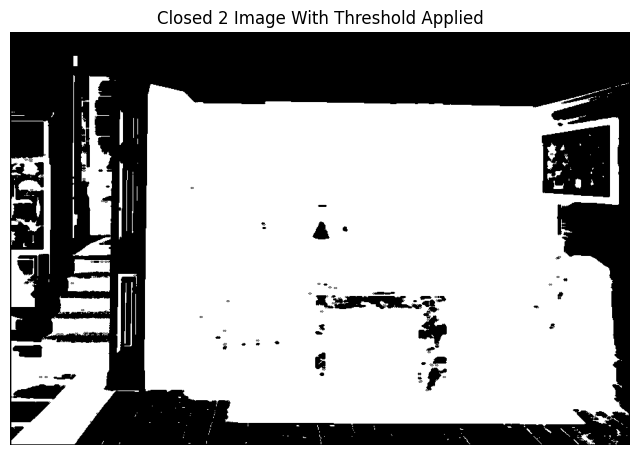

In [ ]:
# Closing.

closed1 = closing_operation(image, structuring_element1)
closed2 = closing_operation(image, structuring_element2)
closed3 = closing_operation(binary_image, structuring_element1)
closed4 = closing_operation(binary_image, structuring_element2)

# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(closed1, cmap='gray')
plt.title('Original Closed Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(closed2, cmap='gray')
plt.title('Original Closed Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(closed3, cmap='gray')
plt.title('Closed 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(closed4, cmap='gray')
plt.title('Closed 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

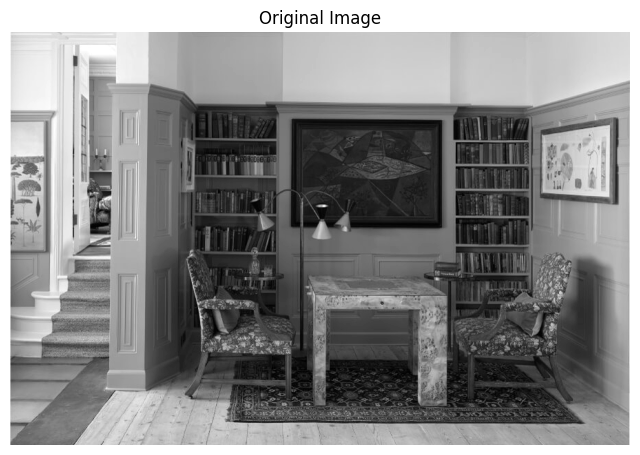

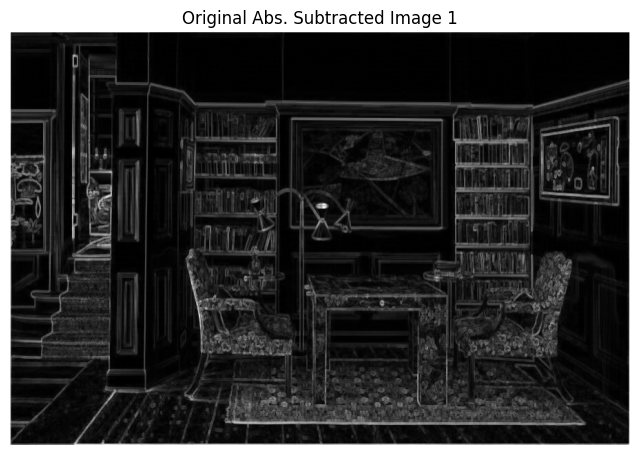

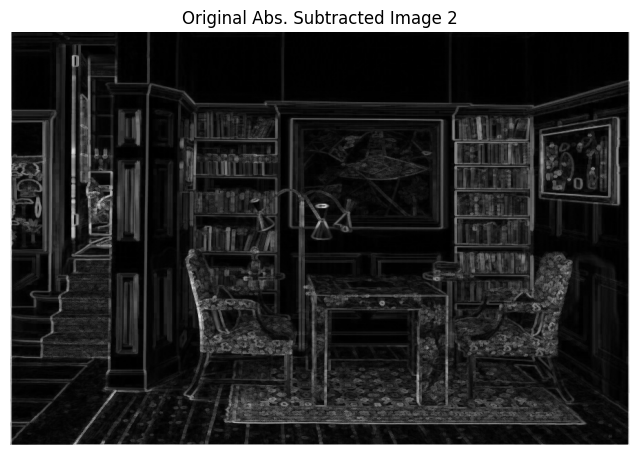

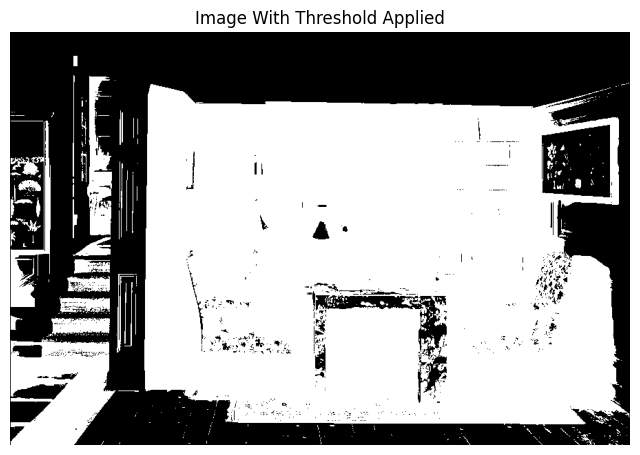

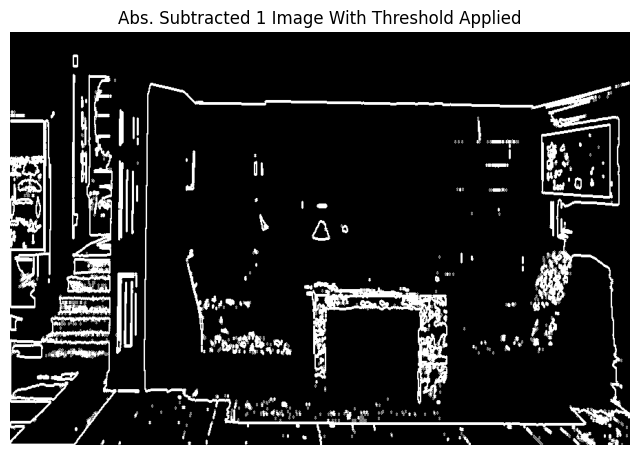

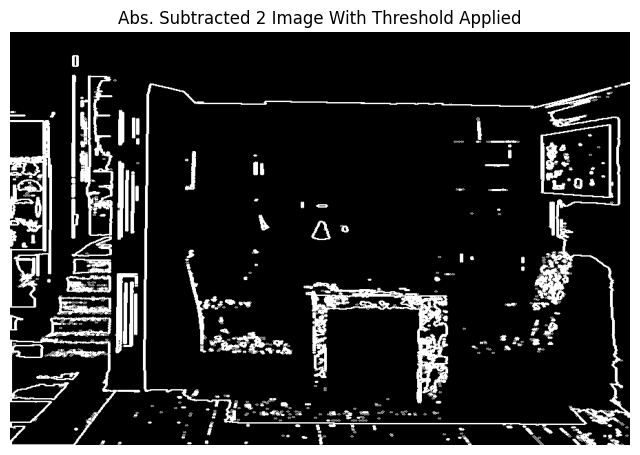

In [ ]:
# Absolute subtraction of Dilation and Erosion.

absolute_abstraction_of_dilanderos1 = np.abs(dilation_operation(image, structuring_element1) - erosion_operation(image, structuring_element1))
absolute_abstraction_of_dilanderos2 = np.abs(dilation_operation(image, structuring_element2) - erosion_operation(image, structuring_element2))
absolute_abstraction_of_dilanderos3 = np.abs(dilation_operation(binary_image, structuring_element1) - erosion_operation(binary_image, structuring_element1))
absolute_abstraction_of_dilanderos4 = np.abs(dilation_operation(binary_image, structuring_element2) - erosion_operation(binary_image, structuring_element2))

# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_dilanderos1, cmap='gray')
plt.title('Original Abs. Subtracted Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_dilanderos2, cmap='gray')
plt.title('Original Abs. Subtracted Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_dilanderos3, cmap='gray')
plt.title('Abs. Subtracted 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_dilanderos4, cmap='gray')
plt.title('Abs. Subtracted 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

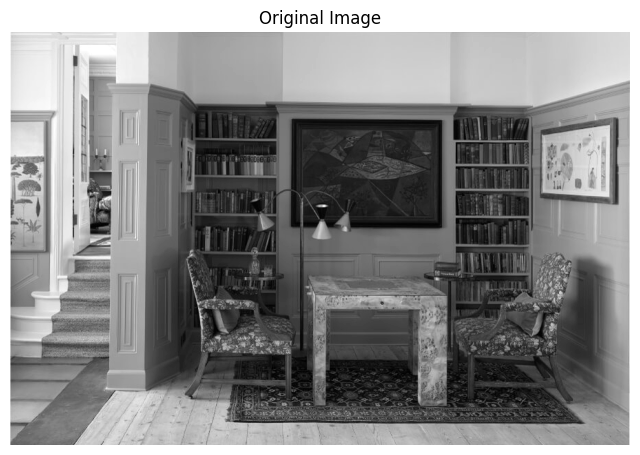

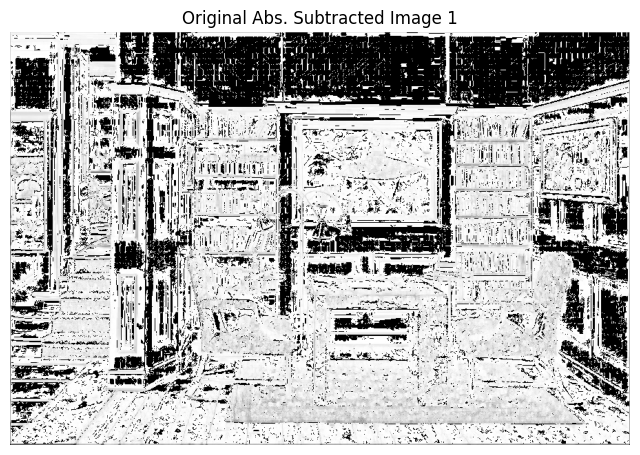

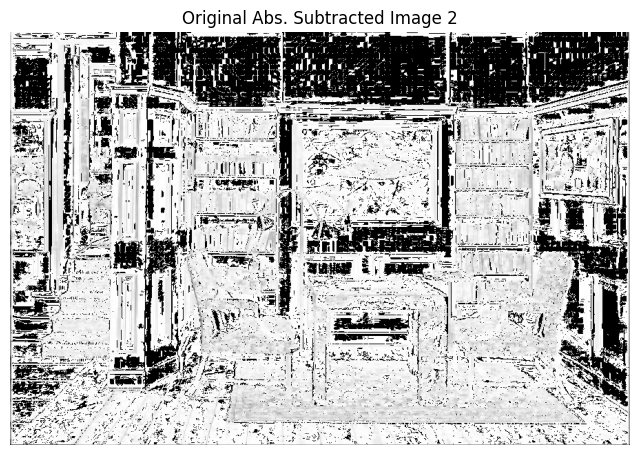

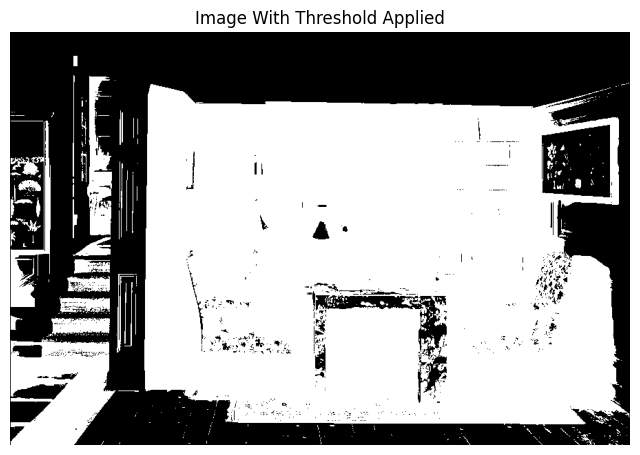

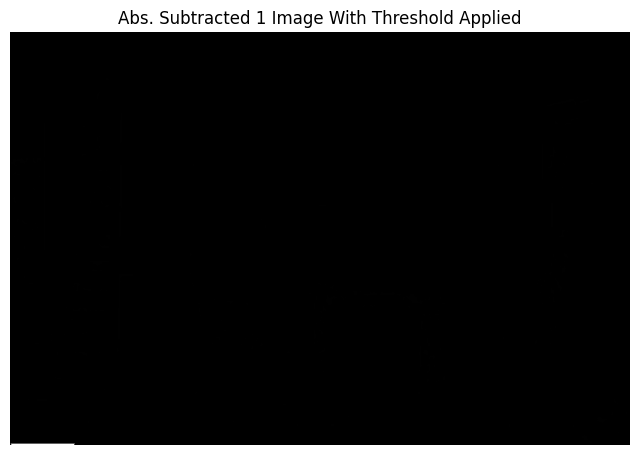

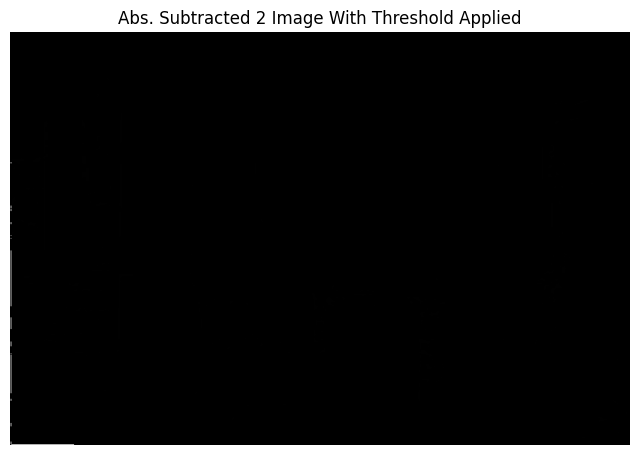

In [ ]:
# Absolute subtraction of Opening and Closing.

absolute_abstraction_of_opandcl1 = np.abs(opening_operation(image, structuring_element1) - closing_operation(image, structuring_element1))
absolute_abstraction_of_opandcl2 = np.abs(opening_operation(image, structuring_element2) - closing_operation(image, structuring_element2))
absolute_abstraction_of_opandcl3 = np.abs(opening_operation(binary_image, structuring_element1) - closing_operation(binary_image, structuring_element1))
absolute_abstraction_of_opandcl4 = np.abs(opening_operation(binary_image, structuring_element2) - closing_operation(binary_image, structuring_element2))

# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opandcl1, cmap='gray')
plt.title('Original Abs. Subtracted Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opandcl2, cmap='gray')
plt.title('Original Abs. Subtracted Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opandcl3, cmap='gray')
plt.title('Abs. Subtracted 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opandcl4, cmap='gray')
plt.title('Abs. Subtracted 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

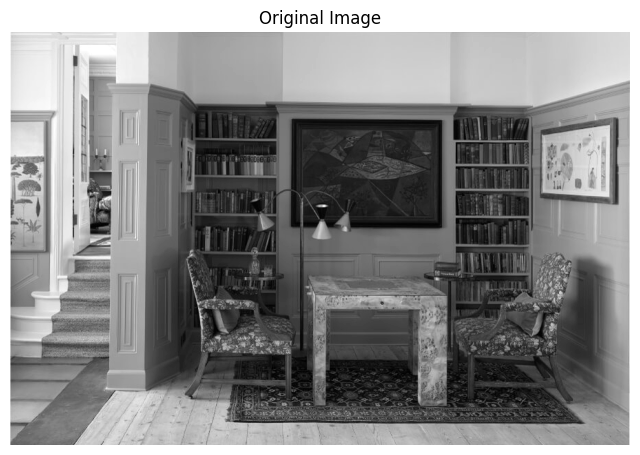

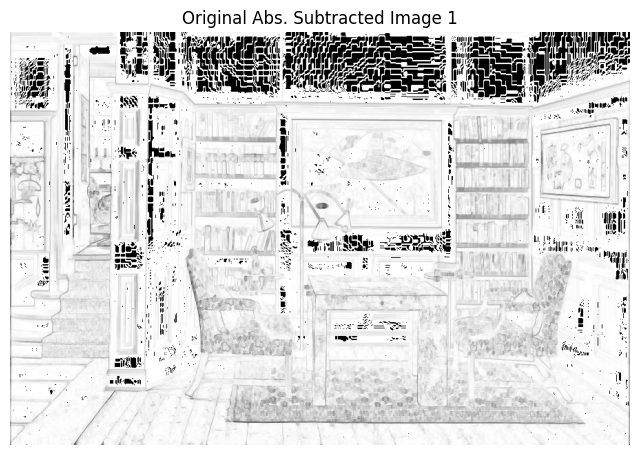

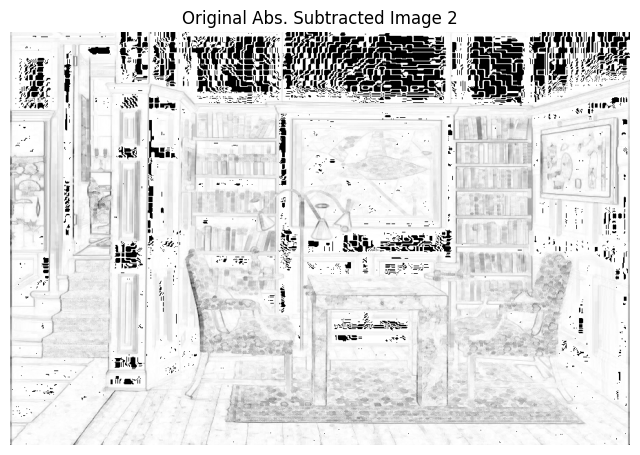

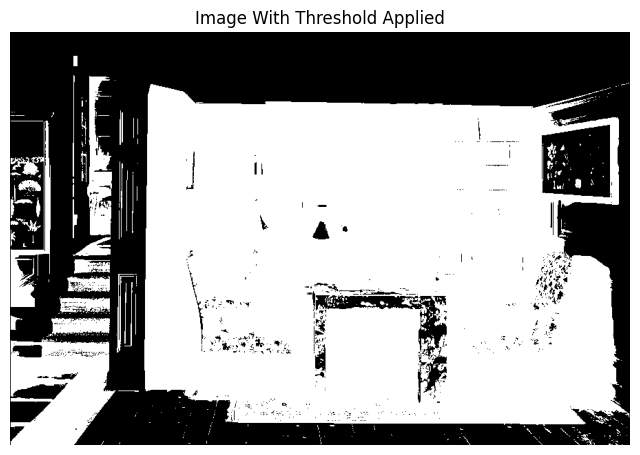

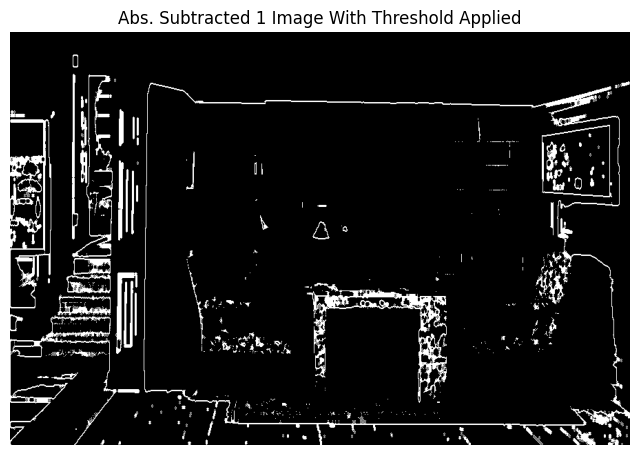

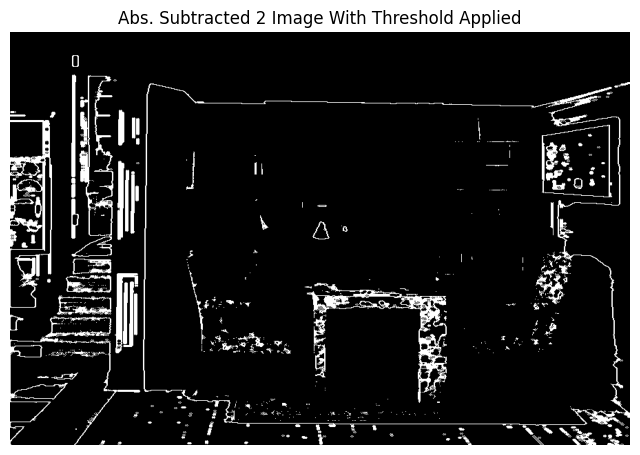

In [ ]:
# Absolute subtraction of Opening and Dilation.

absolute_abstraction_of_opanddil1 = np.abs(opening_operation(image, structuring_element1) - dilation_operation(image, structuring_element1))
absolute_abstraction_of_opanddil2 = np.abs(opening_operation(image, structuring_element2) - dilation_operation(image, structuring_element2))
absolute_abstraction_of_opanddil3 = np.abs(opening_operation(binary_image, structuring_element1) - dilation_operation(binary_image, structuring_element1))
absolute_abstraction_of_opanddil4 = np.abs(opening_operation(binary_image, structuring_element2) - dilation_operation(binary_image, structuring_element2))

# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanddil1, cmap='gray')
plt.title('Original Abs. Subtracted Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanddil2, cmap='gray')
plt.title('Original Abs. Subtracted Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanddil3, cmap='gray')
plt.title('Abs. Subtracted 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanddil4, cmap='gray')
plt.title('Abs. Subtracted 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

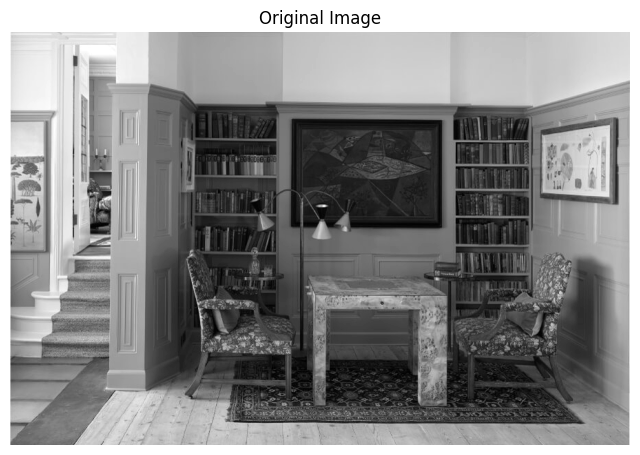

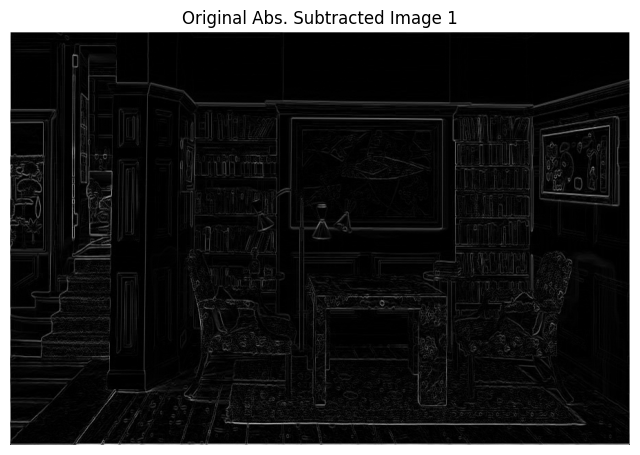

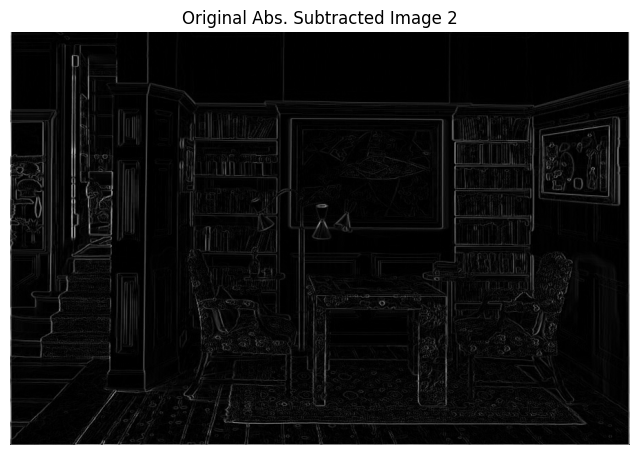

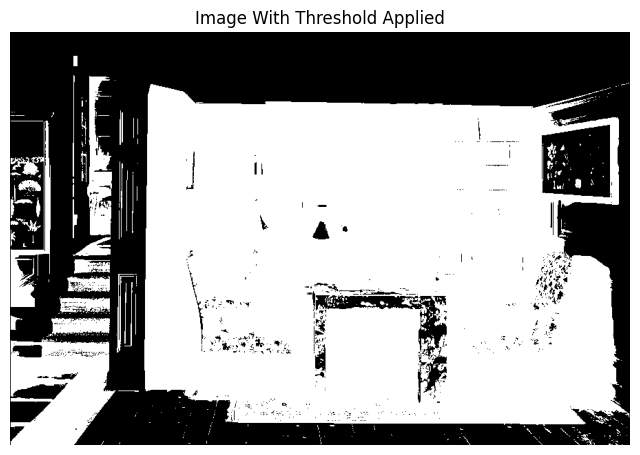

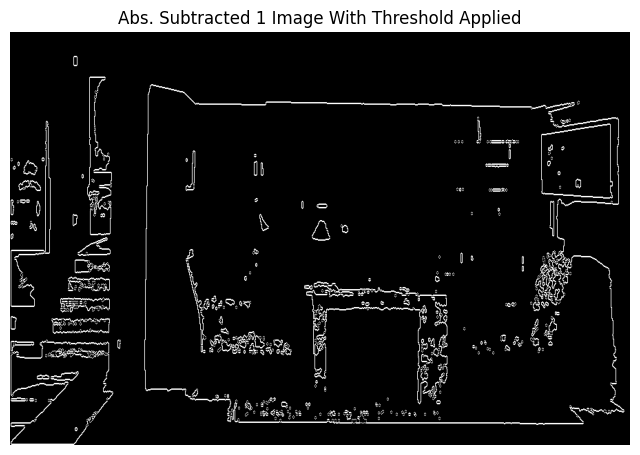

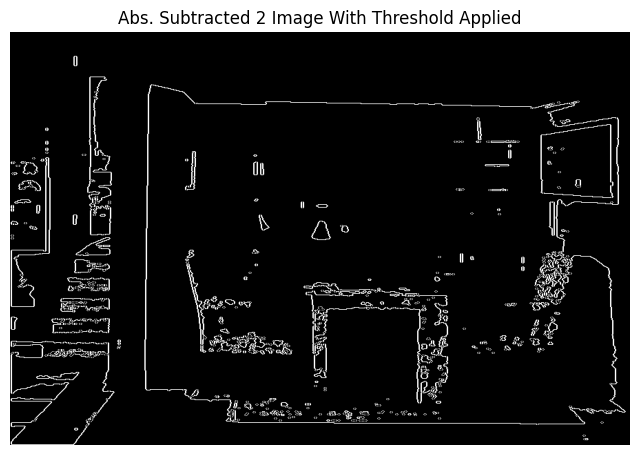

In [ ]:
# Absolute subtraction of Opening and Erosion.

absolute_abstraction_of_opanderos1 = np.abs(opening_operation(image, structuring_element1) - erosion_operation(image, structuring_element1))
absolute_abstraction_of_opanderos2 = np.abs(opening_operation(image, structuring_element2) - erosion_operation(image, structuring_element2))
absolute_abstraction_of_opanderos3 = np.abs(opening_operation(binary_image, structuring_element1) - erosion_operation(binary_image, structuring_element1))
absolute_abstraction_of_opanderos4 = np.abs(opening_operation(binary_image, structuring_element2) - erosion_operation(binary_image, structuring_element2))

# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanderos1, cmap='gray')
plt.title('Original Abs. Subtracted Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanderos2, cmap='gray')
plt.title('Original Abs. Subtracted Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanderos3, cmap='gray')
plt.title('Abs. Subtracted 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanderos4, cmap='gray')
plt.title('Abs. Subtracted 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

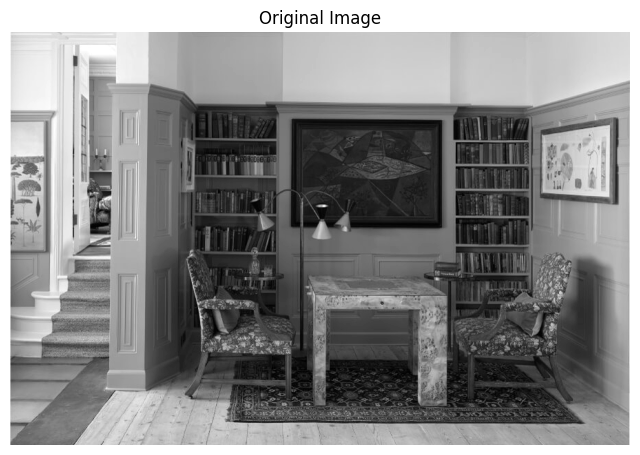

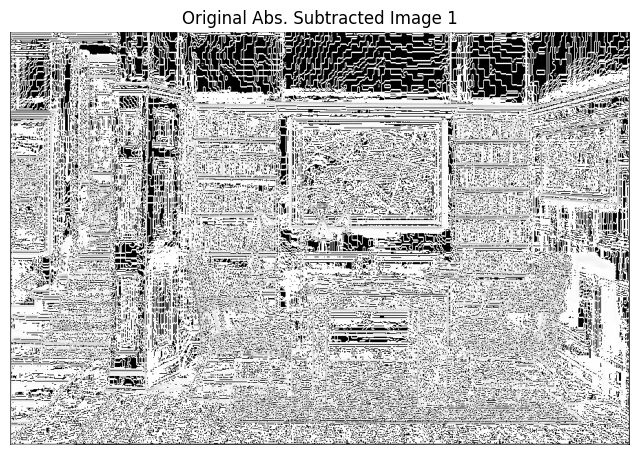

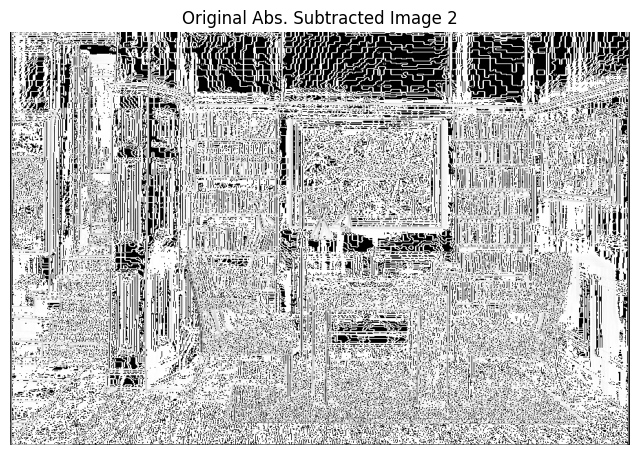

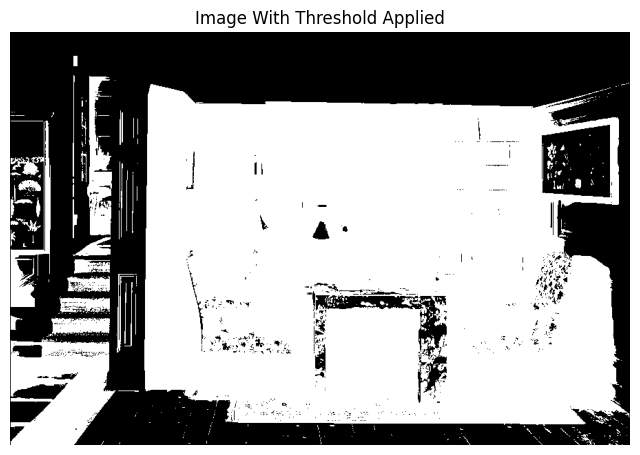

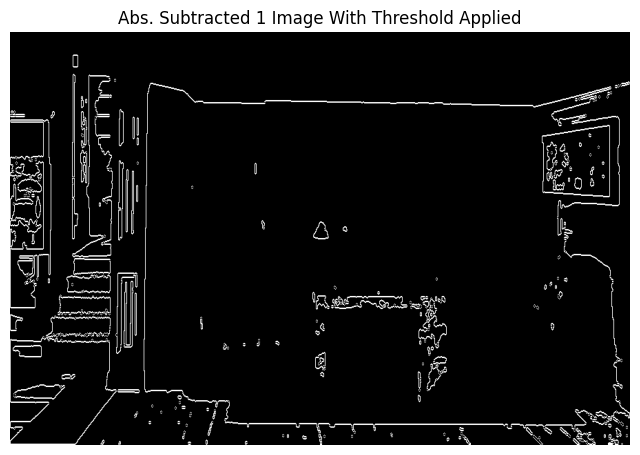

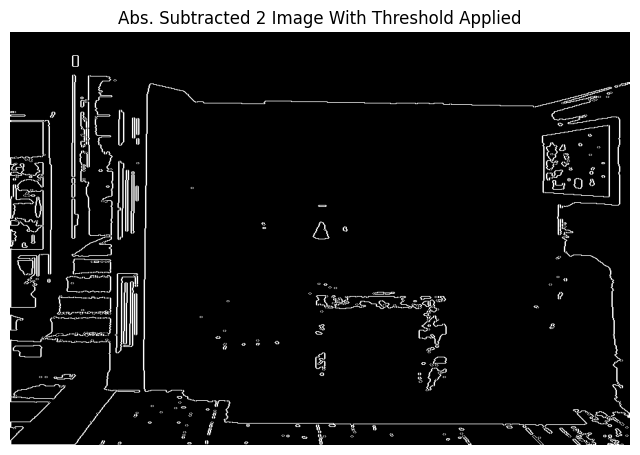

In [ ]:
# Absolute subtraction of Closing and Dilation.

absolute_abstraction_of_closanddil1 = np.abs(closing_operation(image, structuring_element1) - dilation_operation(image, structuring_element1))
absolute_abstraction_of_closanddil2 = np.abs(closing_operation(image, structuring_element2) - dilation_operation(image, structuring_element2))
absolute_abstraction_of_closanddil3 = np.abs(closing_operation(binary_image, structuring_element1) - dilation_operation(binary_image, structuring_element1))
absolute_abstraction_of_closanddil4 = np.abs(closing_operation(binary_image, structuring_element2) - dilation_operation(binary_image, structuring_element2))

# Plot Original Image.
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanddil1, cmap='gray')
plt.title('Original Abs. Subtracted Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanddil2, cmap='gray')
plt.title('Original Abs. Subtracted Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanddil3, cmap='gray')
plt.title('Abs. Subtracted 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanddil4, cmap='gray')
plt.title('Abs. Subtracted 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

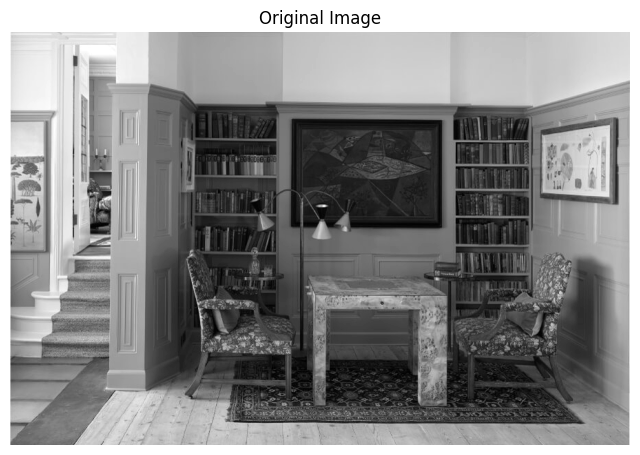

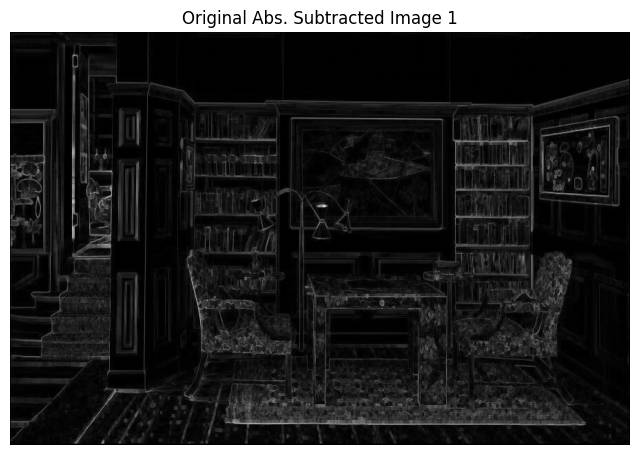

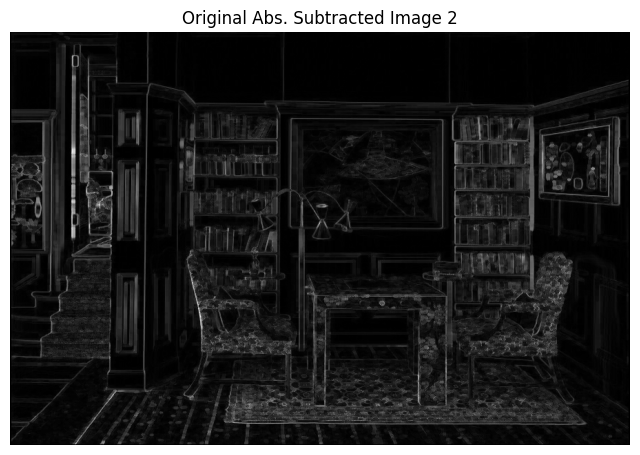

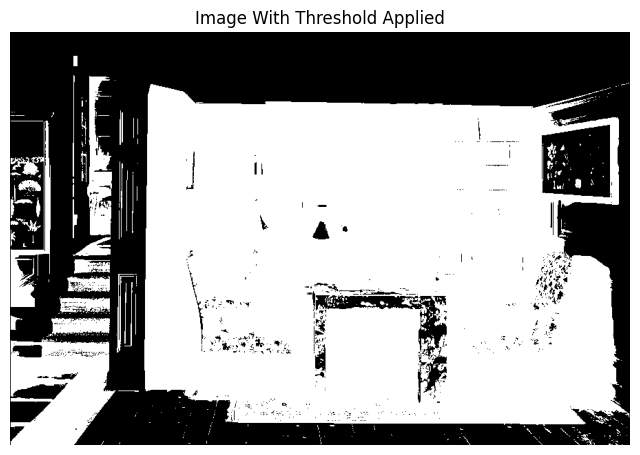

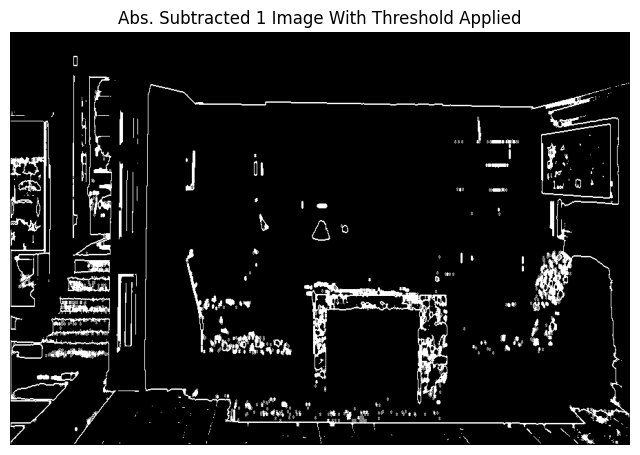

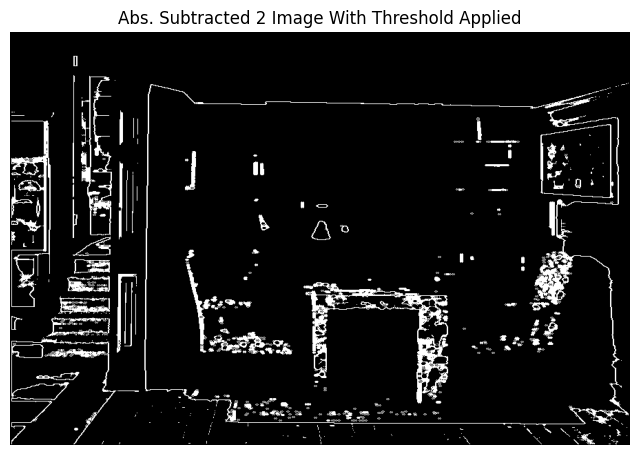

In [ ]:
# Absolute subtraction of Closing and Erosion.

absolute_abstraction_of_closanderos1 = np.abs(closing_operation(image, structuring_element1) - erosion_operation(image, structuring_element1))
absolute_abstraction_of_closanderos2 = np.abs(closing_operation(image, structuring_element2) - erosion_operation(image, structuring_element2))
absolute_abstraction_of_closanderos3 = np.abs(closing_operation(binary_image, structuring_element1) - erosion_operation(binary_image, structuring_element1))
absolute_abstraction_of_closanderos4 = np.abs(closing_operation(binary_image, structuring_element2) - erosion_operation(binary_image, structuring_element2))

# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanderos1, cmap='gray')
plt.title('Original Abs. Subtracted Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanderos2, cmap='gray')
plt.title('Original Abs. Subtracted Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanderos3, cmap='gray')
plt.title('Abs. Subtracted 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanderos4, cmap='gray')
plt.title('Abs. Subtracted 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

# **For Image One: Using Structuring Elements with Zeros and Ones and Equal Size**
Applying The following operations:


1.   Dilation.
2.   Erosion.
3.   Opening.
4.   Closing
5.   Absolute subtraction of Dilation and Erosion..
6.   Absolute subtraction of Opening and Closing.
7.   Absolute subtraction of Opening and Dilation.
8.   Absolute subtraction of Opening and Erosion
9.   Absolute subtraction of Closing and Dilation.
10.  Absolute subtraction of Closing and Erosion


Shape Of Original Image (600, 900)
Shape Of Dilated Image 1 (600, 900)
Shape Of Dilated Image 2 (600, 900)
Shape Of Binary Original Image (600, 900)
Shape Of Binary Dilated Image 1 (600, 900)
Shape Of Binary Dilated Image 2 (600, 900)


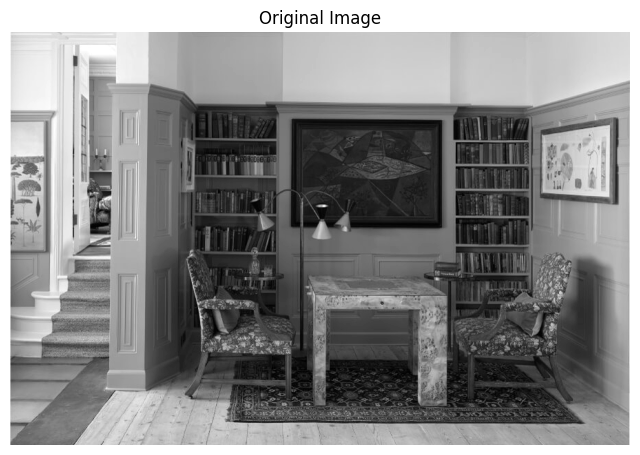

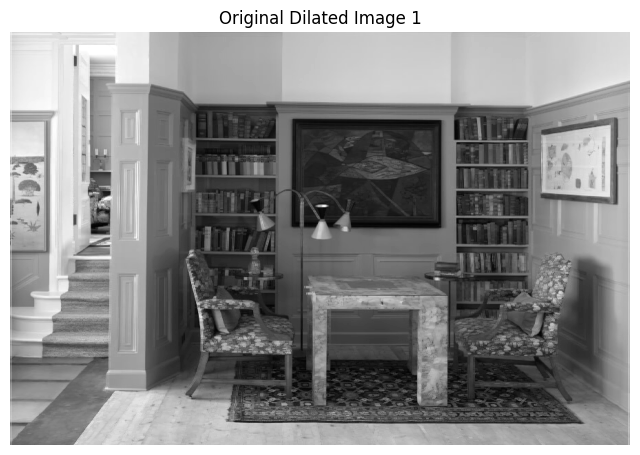

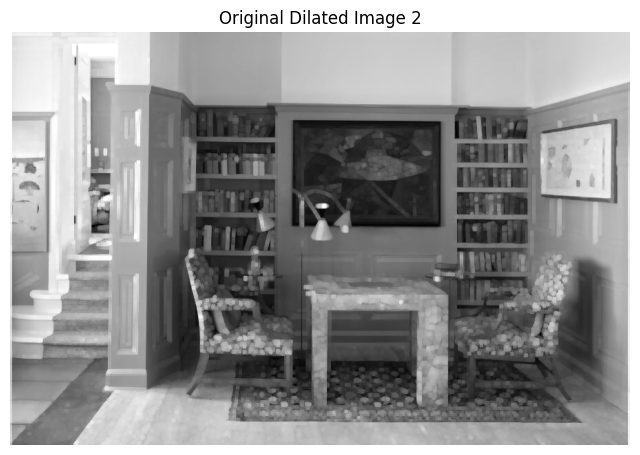

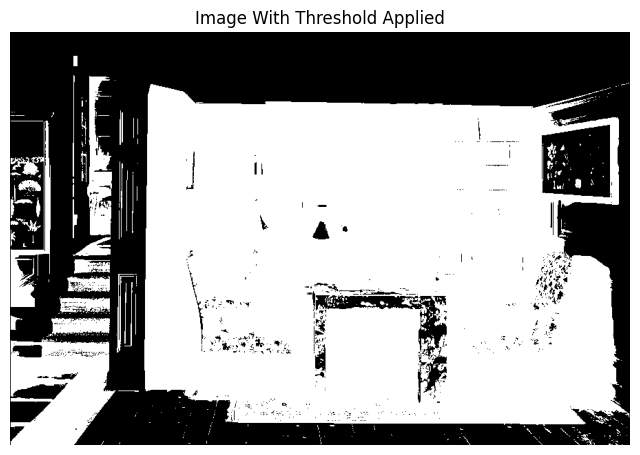

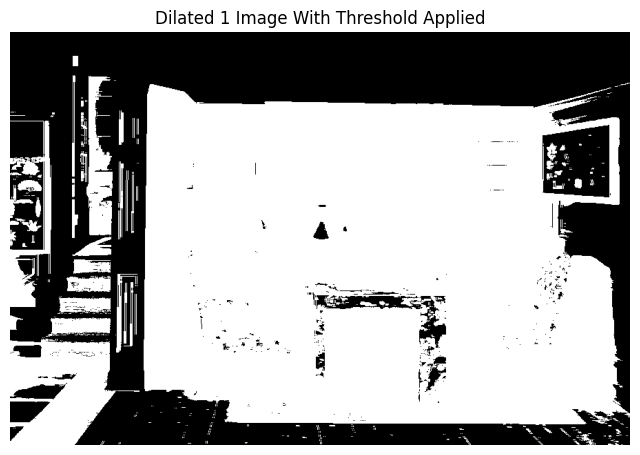

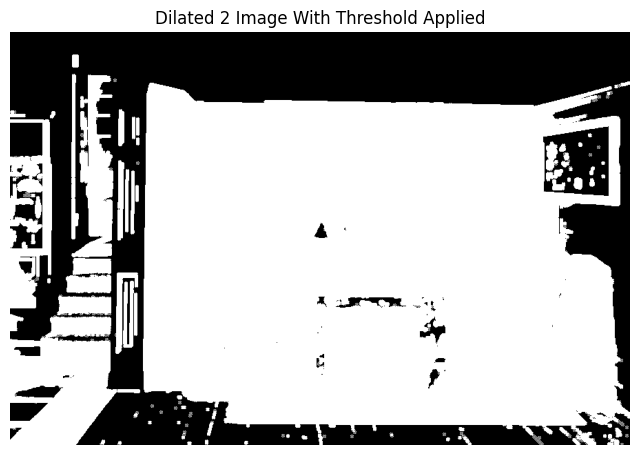

In [ ]:
# Dilation.
image_path = "/content/Test Image 1.jpeg"
image = np.array(Image.open(image_path).convert('L'))
value_of_threshold = 141
_, binary_image = cv2.threshold(image, value_of_threshold, 255, cv2.THRESH_BINARY_INV)
# _, binary_image = cv2.threshold(image, value_of_threshold, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
structuring_element1 = np.array([[0, 0, 0],
                                [1, 0 ,1],
                                [0, 0, 0]])

structuring_element2 = np.array([[0, 1, 0, 1, 0],
                                [1, 0, 1, 0, 1],
                                [0, 1, 0, 1, 0],
                                [1, 0, 1, 0, 1],
                                [0, 1, 0, 1, 0]])

dilated1 = dilation_operation(image, structuring_element1)
dilated2 = dilation_operation(image, structuring_element2)
dilated3 = dilation_operation(binary_image, structuring_element1)
dilated4 = dilation_operation(binary_image, structuring_element2)
print("Shape Of Original Image" , image.shape)
print("Shape Of Dilated Image 1" , dilated1.shape)
print("Shape Of Dilated Image 2" , dilated2.shape)
print("Shape Of Binary Original Image" , binary_image.shape)
print("Shape Of Binary Dilated Image 1" , dilated3.shape)
print("Shape Of Binary Dilated Image 2" , dilated4.shape)
# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(dilated1, cmap='gray')
plt.title('Original Dilated Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(dilated2, cmap='gray')
plt.title('Original Dilated Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(dilated3, cmap='gray')
plt.title('Dilated 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(dilated4, cmap='gray')
plt.title('Dilated 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

Shape Of Original Image (600, 900)
Shape Of Eroded Image 1 (600, 900)
Shape Of Eroded Image 2 (600, 900)
Shape Of Binary Original Image (600, 900)
Shape Of Binary Eroded Image 1 (600, 900)
Shape Of Binary Eroded Image 2 (600, 900)


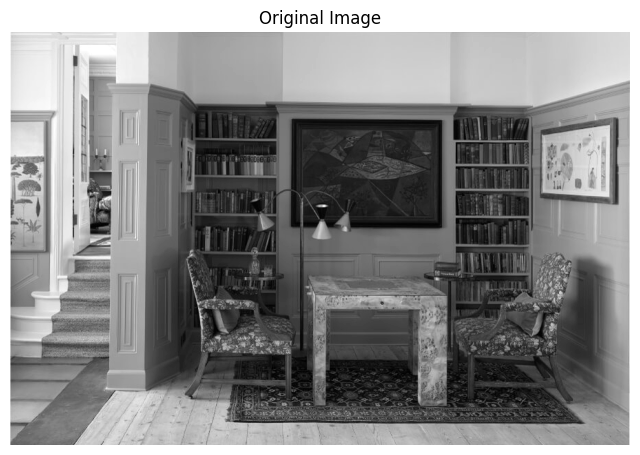

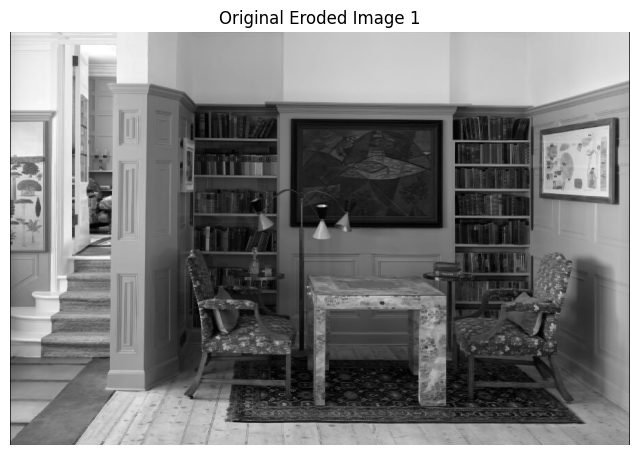

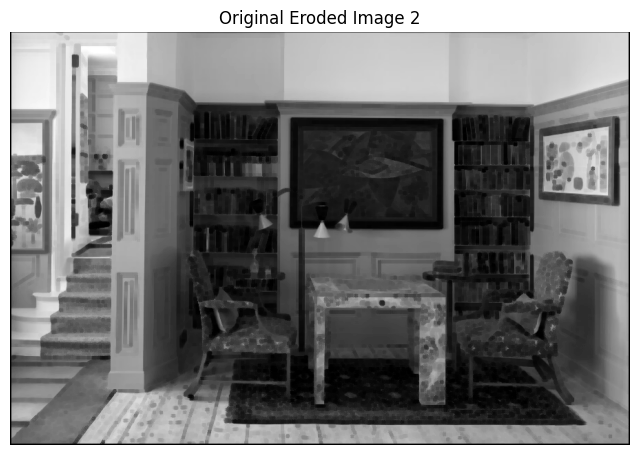

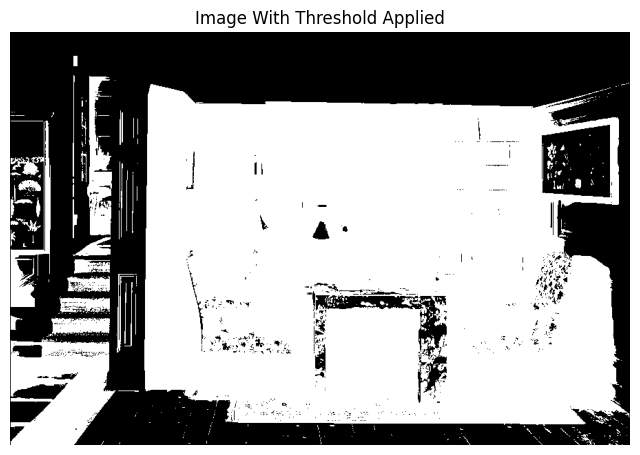

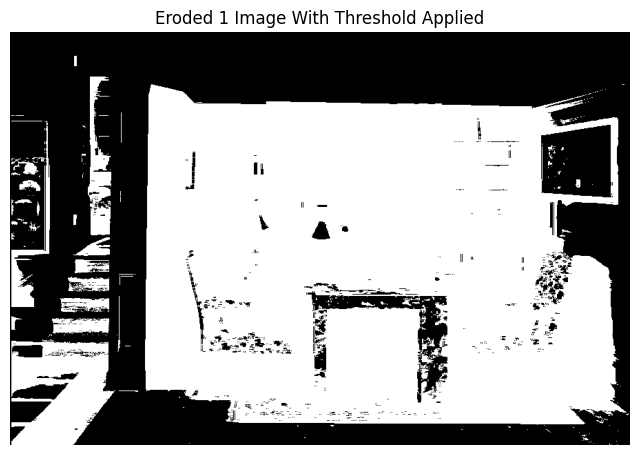

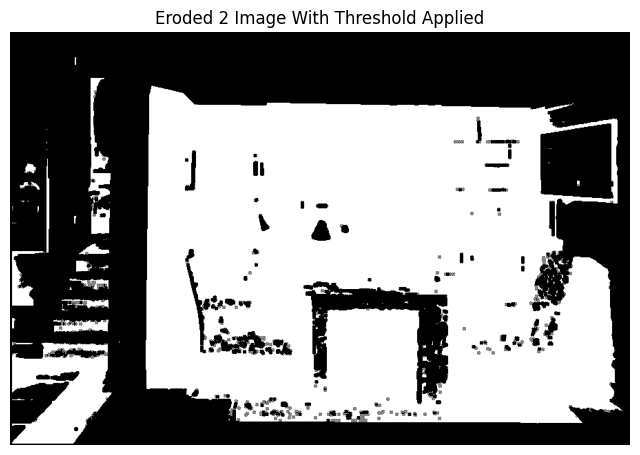

In [ ]:
# Erosion.

eroded1 = erosion_operation(image, structuring_element1)
eroded2 = erosion_operation(image, structuring_element2)
eroded3 = erosion_operation(binary_image, structuring_element1)
eroded4 = erosion_operation(binary_image, structuring_element2)
print("Shape Of Original Image" , image.shape)
print("Shape Of Eroded Image 1" , eroded1.shape)
print("Shape Of Eroded Image 2" , eroded2.shape)
print("Shape Of Binary Original Image" , binary_image.shape)
print("Shape Of Binary Eroded Image 1" , eroded3.shape)
print("Shape Of Binary Eroded Image 2" , eroded4.shape)
# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(eroded1, cmap='gray')
plt.title('Original Eroded Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(eroded2, cmap='gray')
plt.title('Original Eroded Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(eroded3, cmap='gray')
plt.title('Eroded 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(eroded4, cmap='gray')
plt.title('Eroded 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

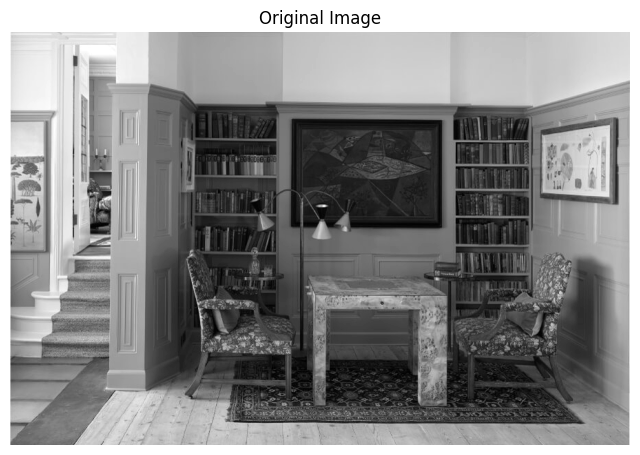

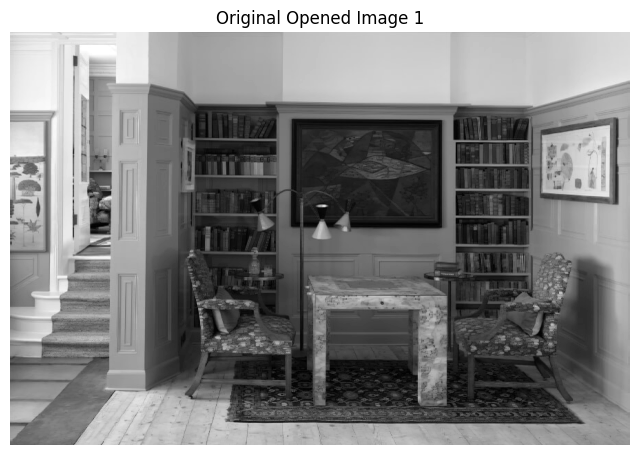

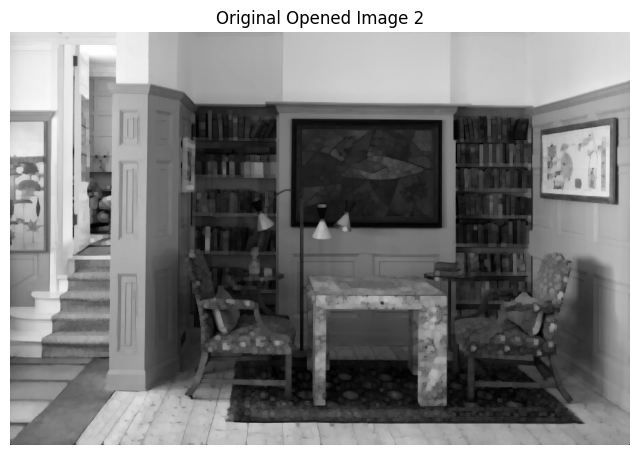

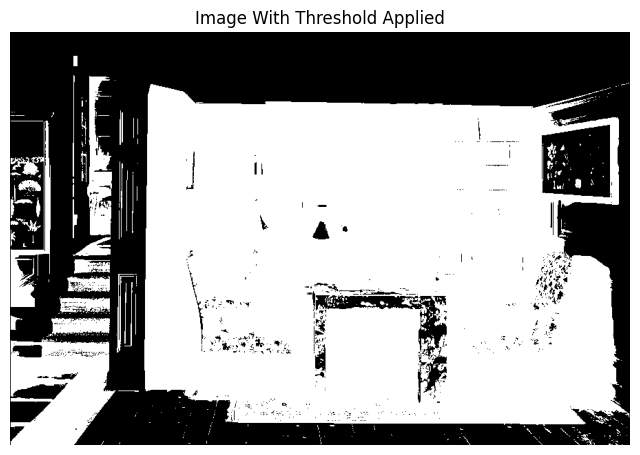

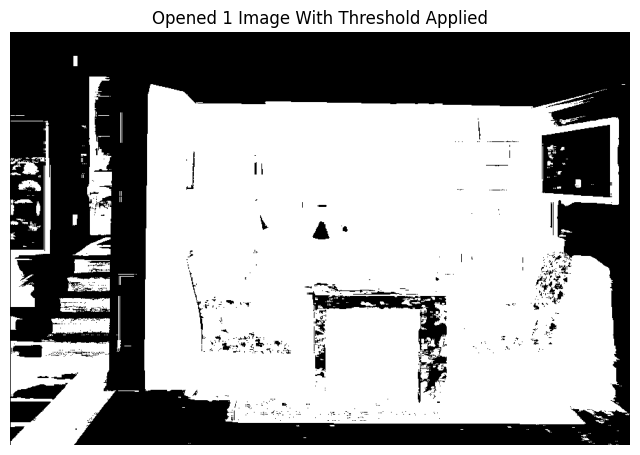

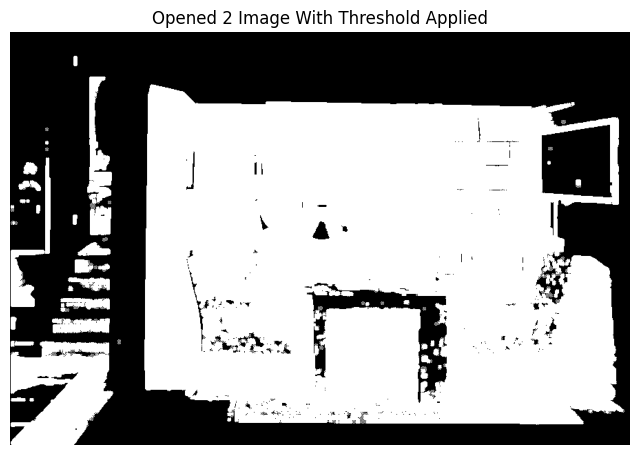

In [ ]:
# Opening.

opned1 = opening_operation(image, structuring_element1)
opned2 = opening_operation(image, structuring_element2)
opned3 = opening_operation(binary_image, structuring_element1)
opned4 = opening_operation(binary_image, structuring_element2)

# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(opned1, cmap='gray')
plt.title('Original Opened Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(opned2, cmap='gray')
plt.title('Original Opened Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(opned3, cmap='gray')
plt.title('Opened 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(opned4, cmap='gray')
plt.title('Opened 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

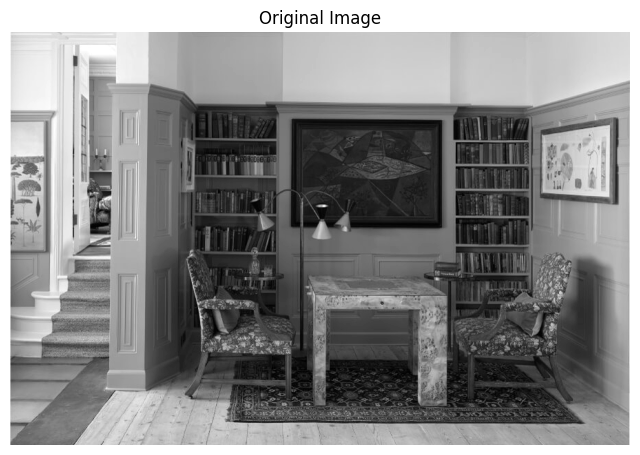

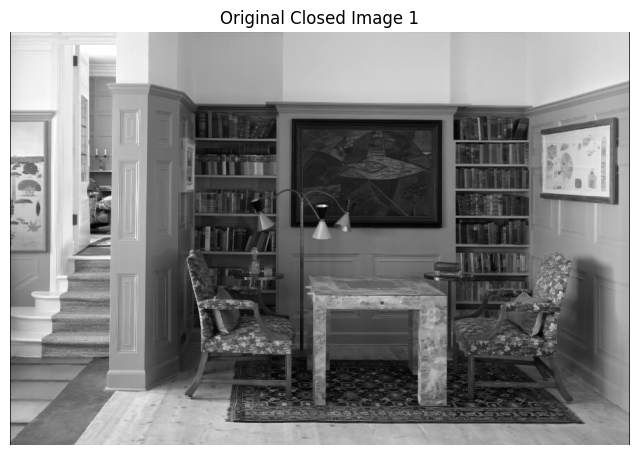

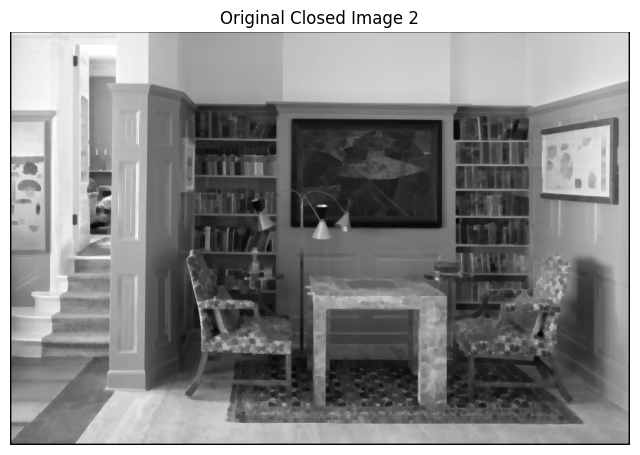

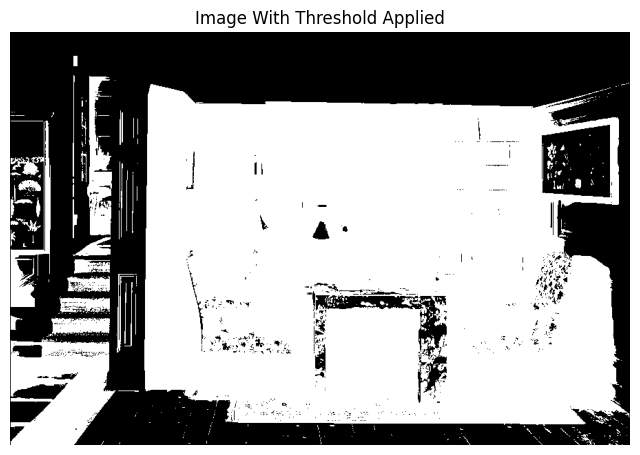

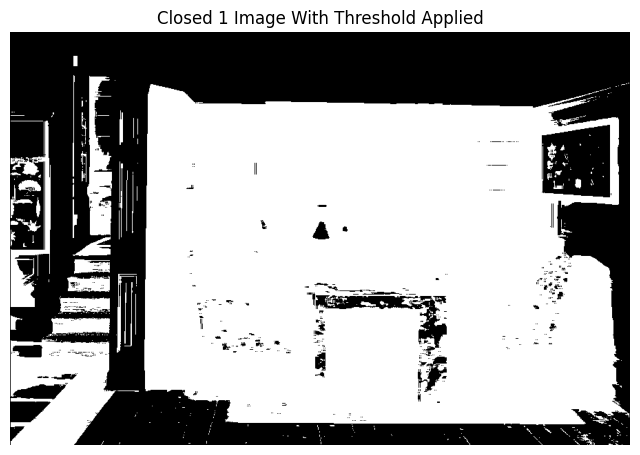

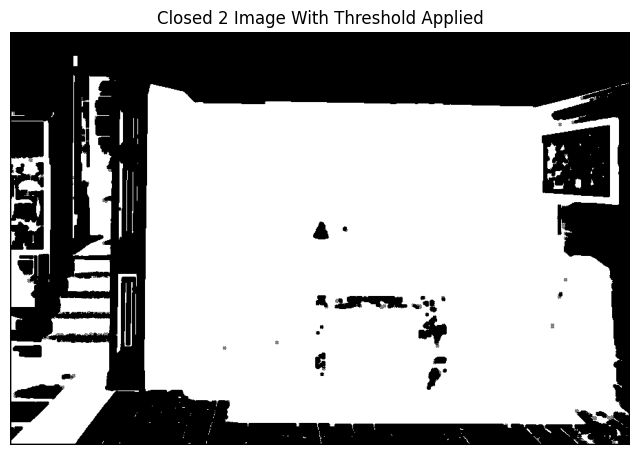

In [ ]:
# Closing.

closed1 = closing_operation(image, structuring_element1)
closed2 = closing_operation(image, structuring_element2)
closed3 = closing_operation(binary_image, structuring_element1)
closed4 = closing_operation(binary_image, structuring_element2)

# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(closed1, cmap='gray')
plt.title('Original Closed Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(closed2, cmap='gray')
plt.title('Original Closed Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(closed3, cmap='gray')
plt.title('Closed 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(closed4, cmap='gray')
plt.title('Closed 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

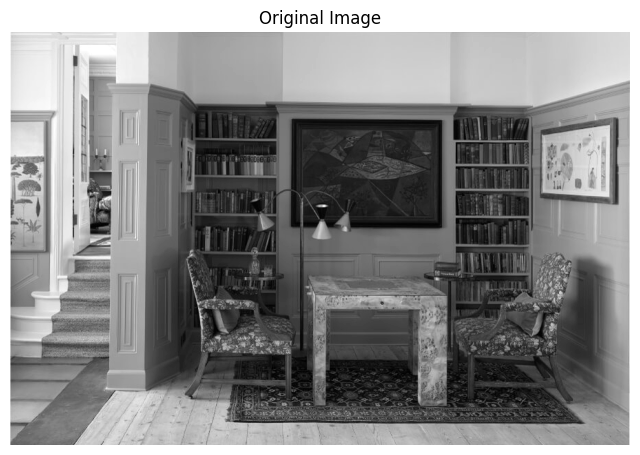

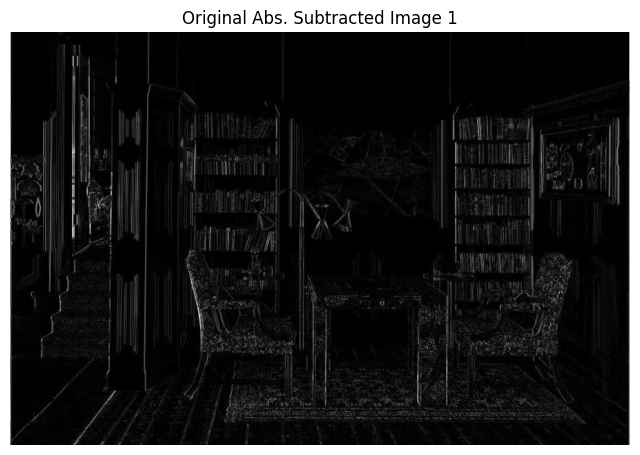

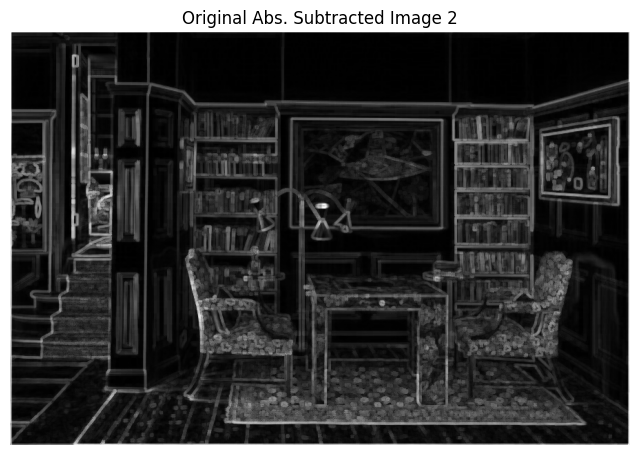

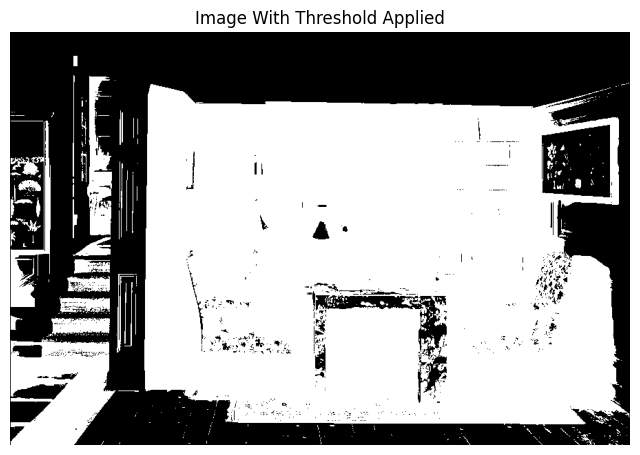

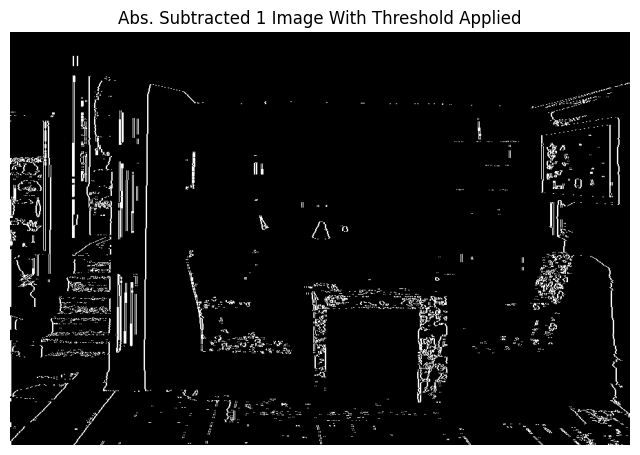

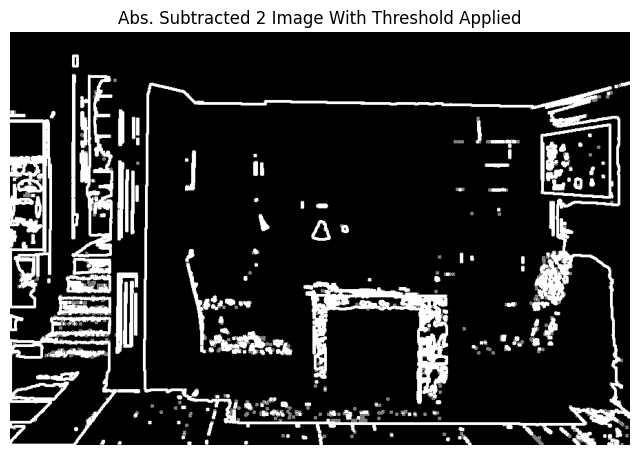

In [ ]:
# Absolute subtraction of Dilation and Erosion.

absolute_abstraction_of_dilanderos1 = np.abs(dilation_operation(image, structuring_element1) - erosion_operation(image, structuring_element1))
absolute_abstraction_of_dilanderos2 = np.abs(dilation_operation(image, structuring_element2) - erosion_operation(image, structuring_element2))
absolute_abstraction_of_dilanderos3 = np.abs(dilation_operation(binary_image, structuring_element1) - erosion_operation(binary_image, structuring_element1))
absolute_abstraction_of_dilanderos4 = np.abs(dilation_operation(binary_image, structuring_element2) - erosion_operation(binary_image, structuring_element2))

# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_dilanderos1, cmap='gray')
plt.title('Original Abs. Subtracted Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_dilanderos2, cmap='gray')
plt.title('Original Abs. Subtracted Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_dilanderos3, cmap='gray')
plt.title('Abs. Subtracted 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_dilanderos4, cmap='gray')
plt.title('Abs. Subtracted 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

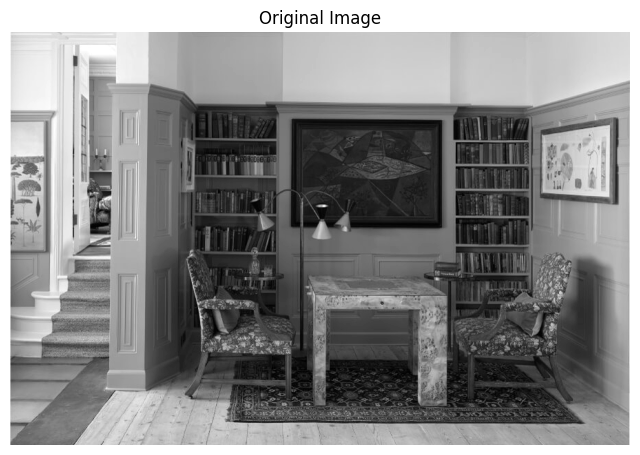

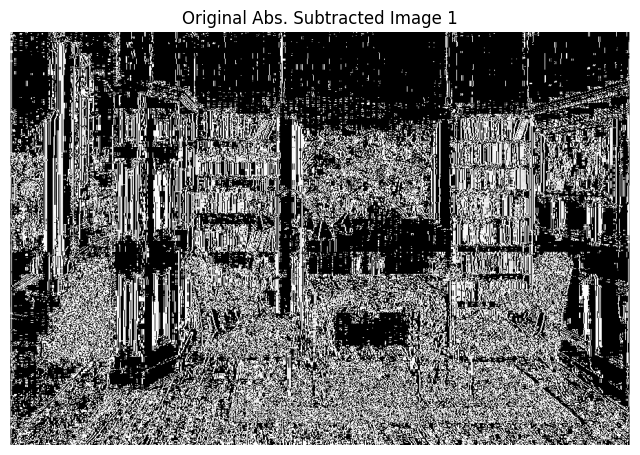

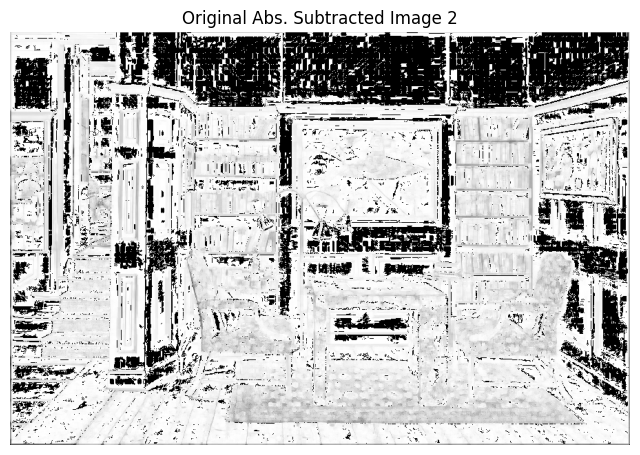

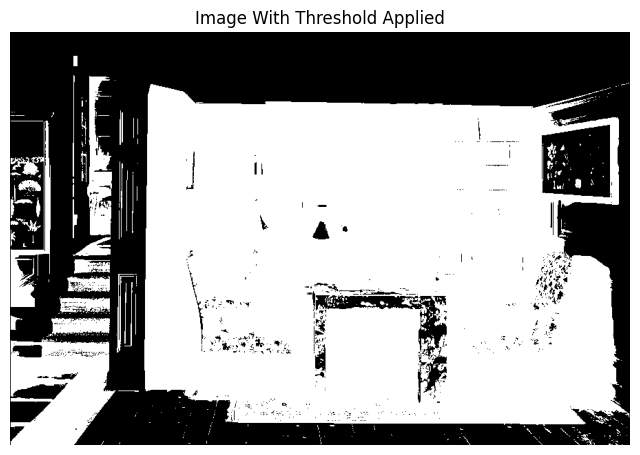

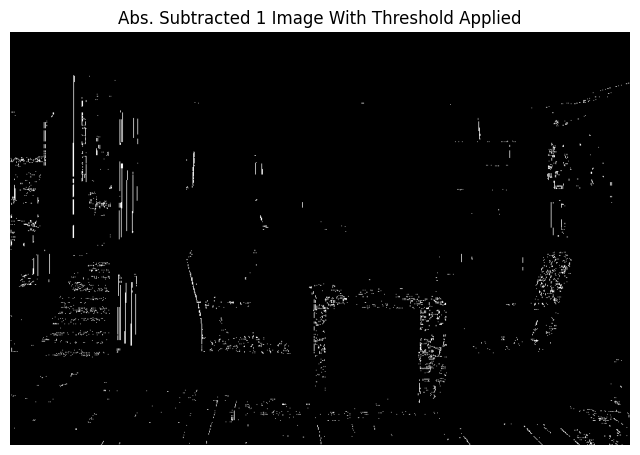

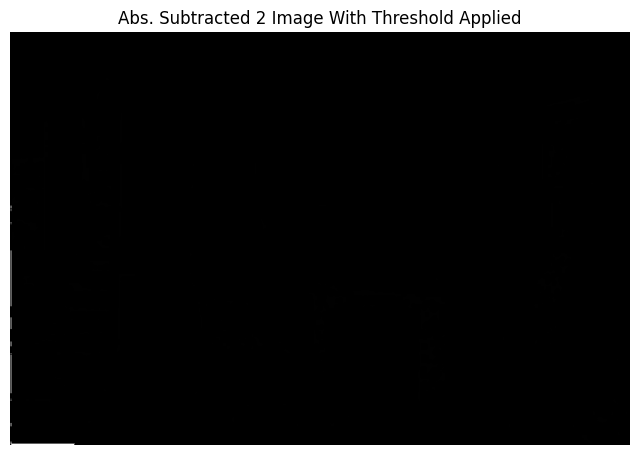

In [ ]:
# Absolute subtraction of Opening and Closing.

absolute_abstraction_of_opandcl1 = np.abs(opening_operation(image, structuring_element1) - closing_operation(image, structuring_element1))
absolute_abstraction_of_opandcl2 = np.abs(opening_operation(image, structuring_element2) - closing_operation(image, structuring_element2))
absolute_abstraction_of_opandcl3 = np.abs(opening_operation(binary_image, structuring_element1) - closing_operation(binary_image, structuring_element1))
absolute_abstraction_of_opandcl4 = np.abs(opening_operation(binary_image, structuring_element2) - closing_operation(binary_image, structuring_element2))

# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opandcl1, cmap='gray')
plt.title('Original Abs. Subtracted Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opandcl2, cmap='gray')
plt.title('Original Abs. Subtracted Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opandcl3, cmap='gray')
plt.title('Abs. Subtracted 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opandcl4, cmap='gray')
plt.title('Abs. Subtracted 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

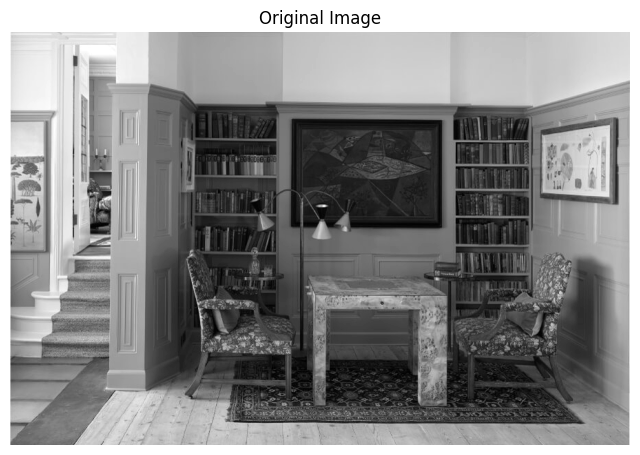

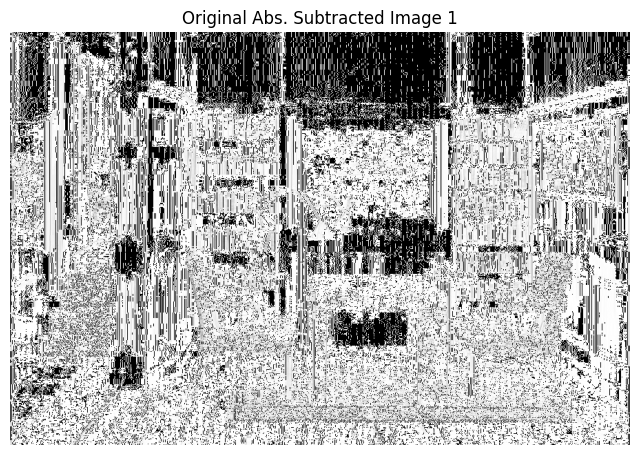

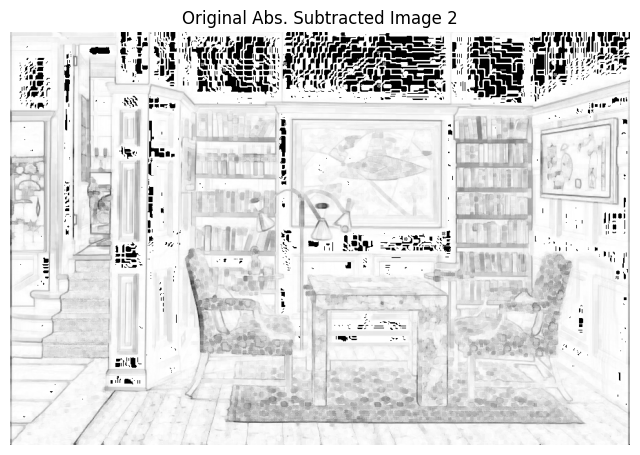

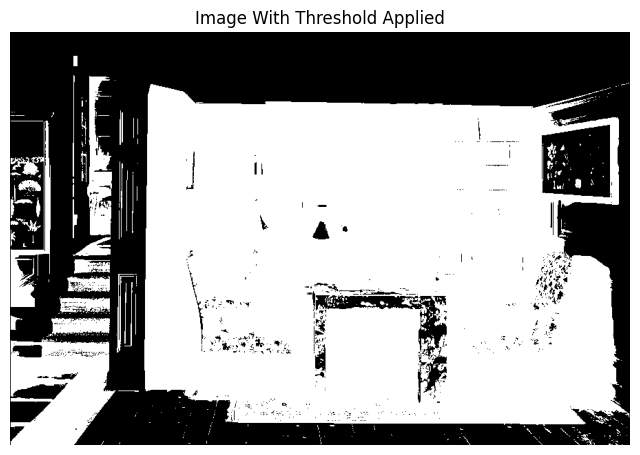

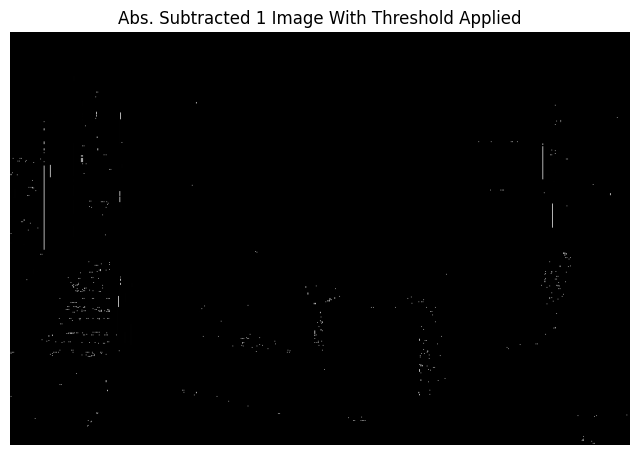

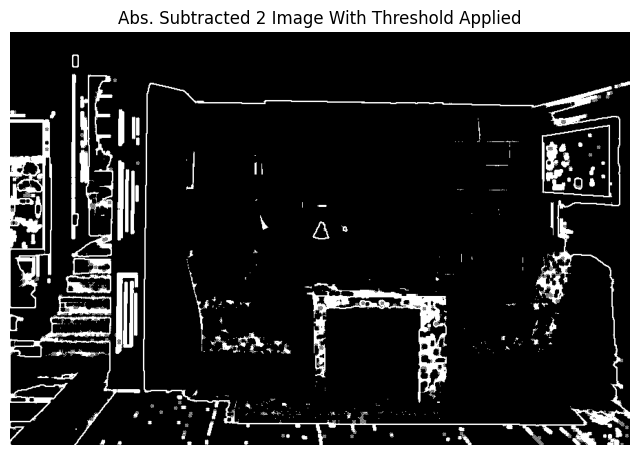

In [ ]:
# Absolute subtraction of Opening and Dilation.

absolute_abstraction_of_opanddil1 = np.abs(opening_operation(image, structuring_element1) - dilation_operation(image, structuring_element1))
absolute_abstraction_of_opanddil2 = np.abs(opening_operation(image, structuring_element2) - dilation_operation(image, structuring_element2))
absolute_abstraction_of_opanddil3 = np.abs(opening_operation(binary_image, structuring_element1) - dilation_operation(binary_image, structuring_element1))
absolute_abstraction_of_opanddil4 = np.abs(opening_operation(binary_image, structuring_element2) - dilation_operation(binary_image, structuring_element2))

# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanddil1, cmap='gray')
plt.title('Original Abs. Subtracted Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanddil2, cmap='gray')
plt.title('Original Abs. Subtracted Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanddil3, cmap='gray')
plt.title('Abs. Subtracted 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanddil4, cmap='gray')
plt.title('Abs. Subtracted 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

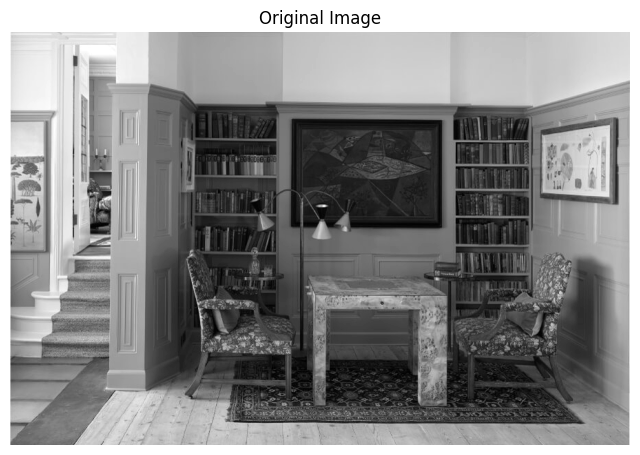

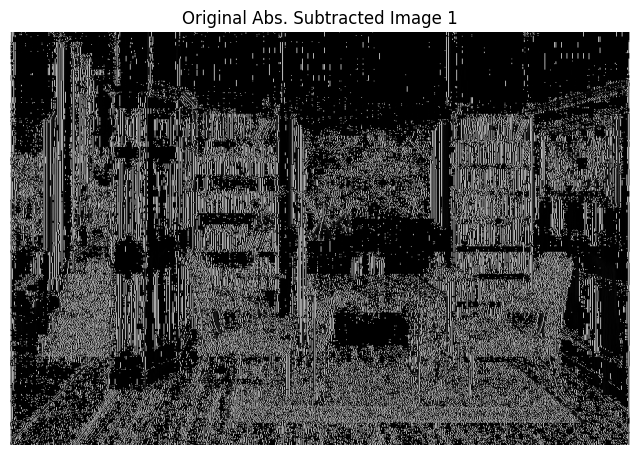

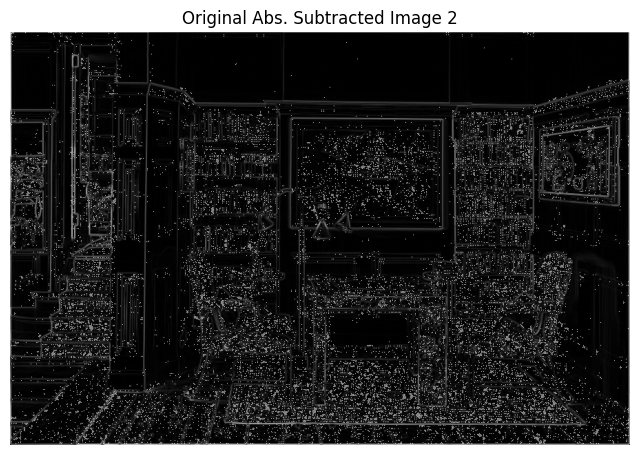

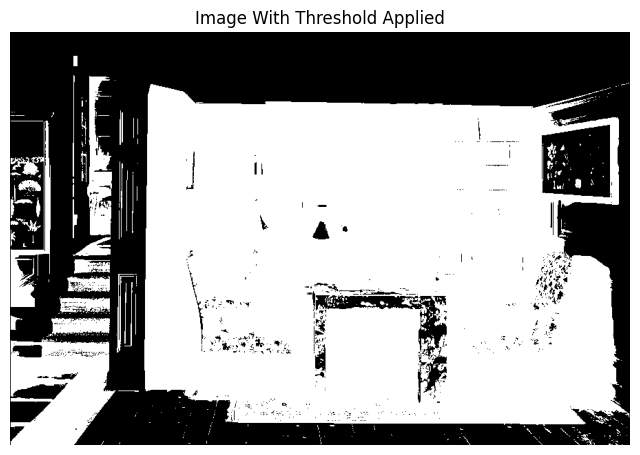

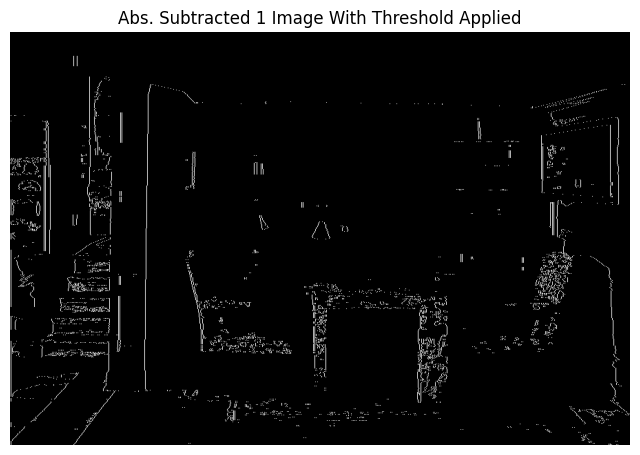

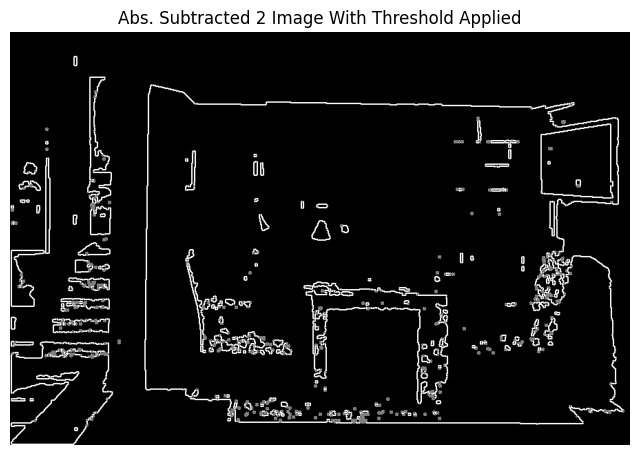

In [ ]:
# Absolute subtraction of Opening and Erosion.

absolute_abstraction_of_opanderos1 = np.abs(opening_operation(image, structuring_element1) - erosion_operation(image, structuring_element1))
absolute_abstraction_of_opanderos2 = np.abs(opening_operation(image, structuring_element2) - erosion_operation(image, structuring_element2))
absolute_abstraction_of_opanderos3 = np.abs(opening_operation(binary_image, structuring_element1) - erosion_operation(binary_image, structuring_element1))
absolute_abstraction_of_opanderos4 = np.abs(opening_operation(binary_image, structuring_element2) - erosion_operation(binary_image, structuring_element2))

# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanderos1, cmap='gray')
plt.title('Original Abs. Subtracted Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanderos2, cmap='gray')
plt.title('Original Abs. Subtracted Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanderos3, cmap='gray')
plt.title('Abs. Subtracted 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_opanderos4, cmap='gray')
plt.title('Abs. Subtracted 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

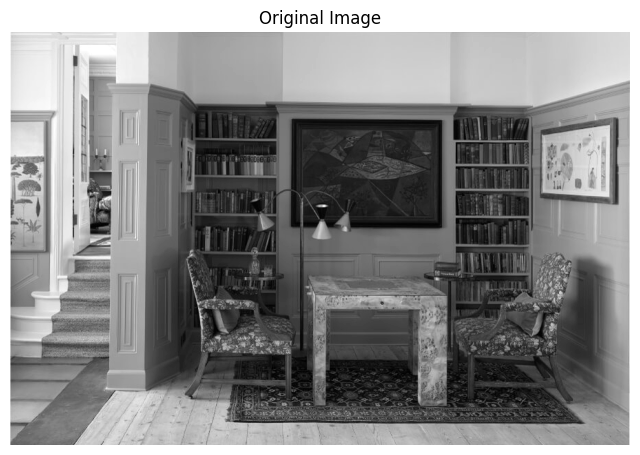

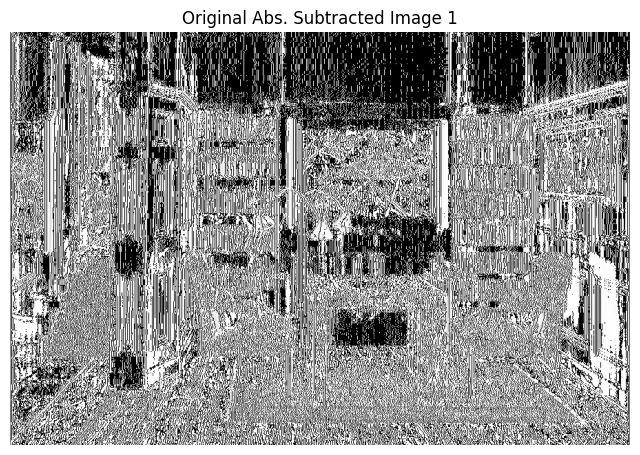

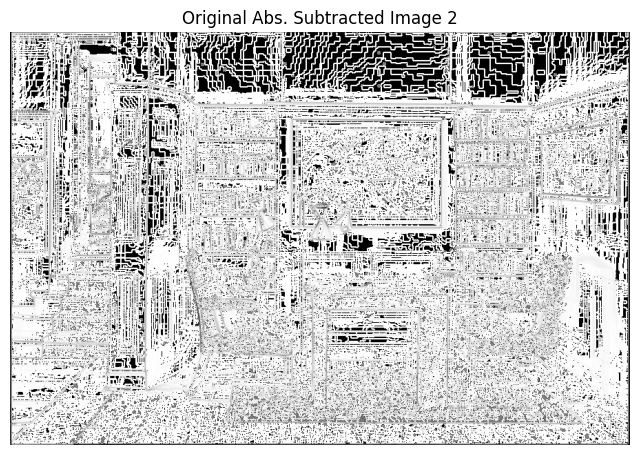

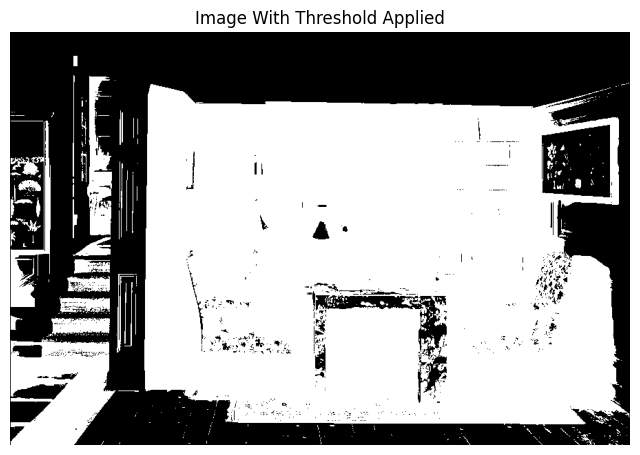

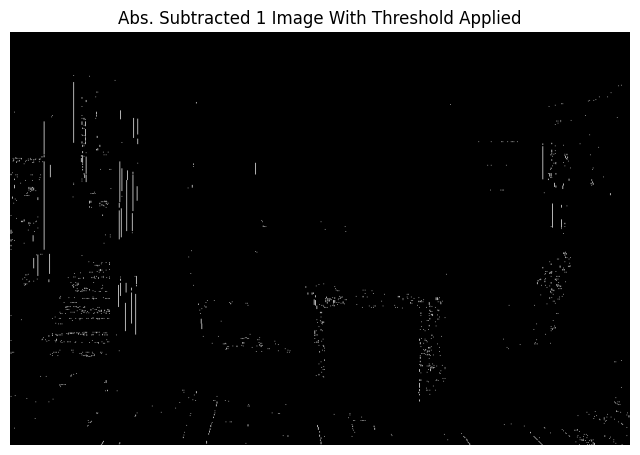

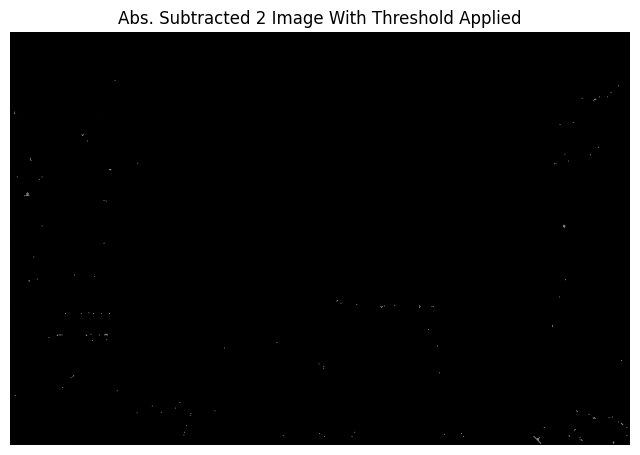

In [ ]:
# Absolute subtraction of Closing and Dilation.

absolute_abstraction_of_closanddil1 = np.abs(closing_operation(image, structuring_element1) - dilation_operation(image, structuring_element1))
absolute_abstraction_of_closanddil2 = np.abs(closing_operation(image, structuring_element2) - dilation_operation(image, structuring_element2))
absolute_abstraction_of_closanddil3 = np.abs(closing_operation(binary_image, structuring_element1) - dilation_operation(binary_image, structuring_element1))
absolute_abstraction_of_closanddil4 = np.abs(closing_operation(binary_image, structuring_element2) - dilation_operation(binary_image, structuring_element2))

# Plot Original Image.
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanddil1, cmap='gray')
plt.title('Original Abs. Subtracted Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanddil2, cmap='gray')
plt.title('Original Abs. Subtracted Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanddil3, cmap='gray')
plt.title('Abs. Subtracted 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanddil4, cmap='gray')
plt.title('Abs. Subtracted 2 Image With Threshold Applied')
plt.axis('off')
plt.show()

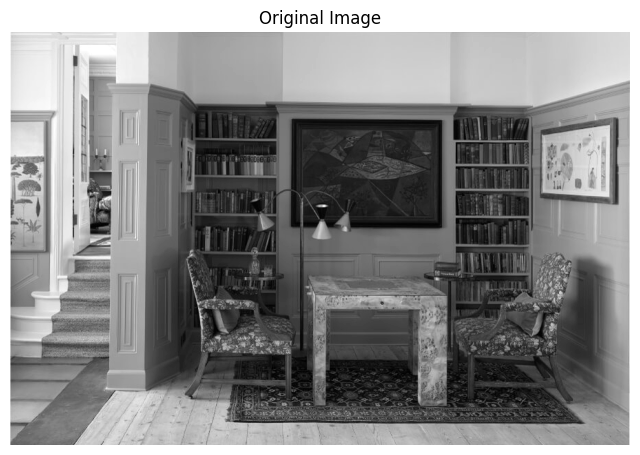

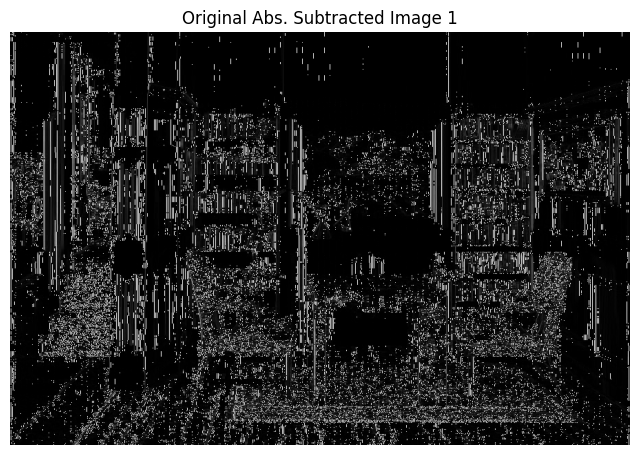

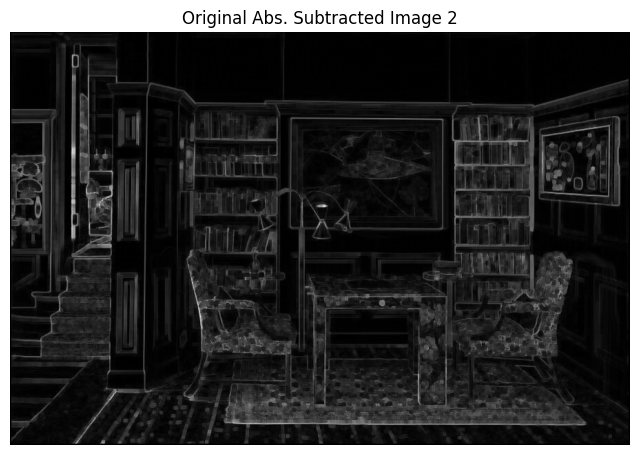

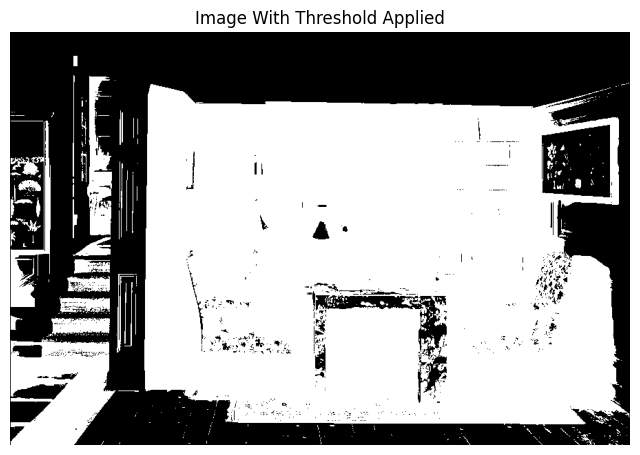

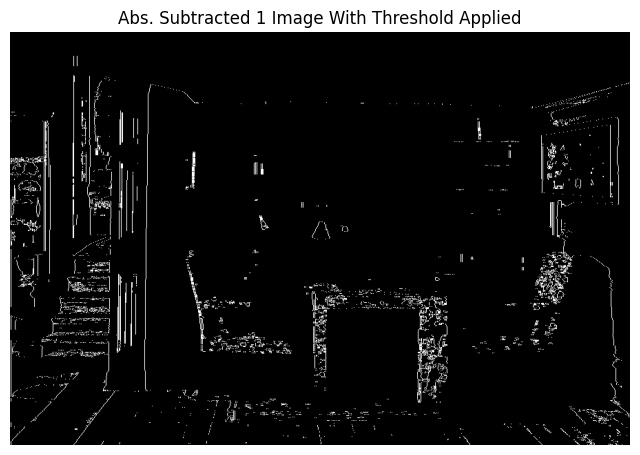

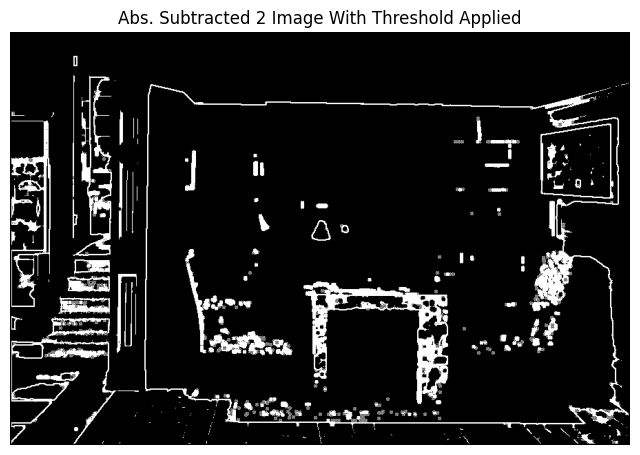

In [ ]:
# Absolute subtraction of Closing and Erosion.

absolute_abstraction_of_closanderos1 = np.abs(closing_operation(image, structuring_element1) - erosion_operation(image, structuring_element1))
absolute_abstraction_of_closanderos2 = np.abs(closing_operation(image, structuring_element2) - erosion_operation(image, structuring_element2))
absolute_abstraction_of_closanderos3 = np.abs(closing_operation(binary_image, structuring_element1) - erosion_operation(binary_image, structuring_element1))
absolute_abstraction_of_closanderos4 = np.abs(closing_operation(binary_image, structuring_element2) - erosion_operation(binary_image, structuring_element2))

# Plot Original Image
plt.figure(figsize=(8, 8))
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')
plt.show()
# Plot Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanderos1, cmap='gray')
plt.title('Original Abs. Subtracted Image 1')
plt.axis('off')
plt.show()
# Plot Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanderos2, cmap='gray')
plt.title('Original Abs. Subtracted Image 2')
plt.axis('off')
plt.show()

# Plot Thresholded Image
plt.figure(figsize=(8, 8))
plt.imshow(binary_image, cmap='gray')
plt.title('Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 1 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanderos3, cmap='gray')
plt.title('Abs. Subtracted 1 Image With Threshold Applied')
plt.axis('off')
plt.show()

# Plot Thresholded Modified 2 Image
plt.figure(figsize=(8, 8))
plt.imshow(absolute_abstraction_of_closanderos4, cmap='gray')
plt.title('Abs. Subtracted 2 Image With Threshold Applied')
plt.axis('off')
plt.show()